<a href="https://colab.research.google.com/github/wgremoliche/AnalisisyVisualizacion/blob/master/AprendizajeNOSupervisado/ANS_TP_clustering_fifa2022_Colab_11_10_22.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center>

## Trabajo Práctico de Aprendizaje No Supervisado DiploDatos
  **Integrantes**

Victor Nicolas Rocco

Maria Mercedes Silva

Santiago Franco

Williams Gremoliche
## Agrupamiento con el FIFA 2022 dataset

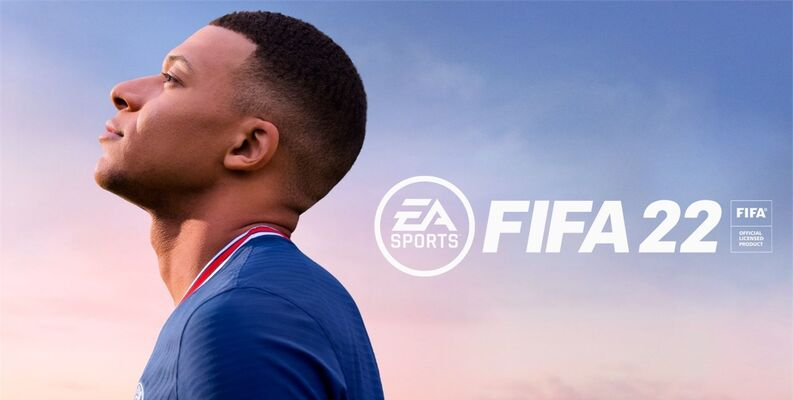
    

## 0.-Inicialización-del-entorno

**Empezamos cargando algunas herramientas para cargar los datos y manipularlos.**

In [1]:
#010 Importación de librerias a usar

import numpy as np
import pandas as pd
import seaborn as sns

from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans,MeanShift
from sklearn.mixture import GaussianMixture
from sklearn import decomposition
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.datasets import make_blobs

pd.set_option('display.max_columns',100)
pd.set_option('display.max_rows',1000)
import itertools
import warnings
warnings.filterwarnings("ignore")
import io

from plotly.offline import init_notebook_mode, plot,iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import plotly.tools as tls #visualization
import plotly.figure_factory as ff #visualization
from mpl_toolkits.mplot3d import Axes3D

import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import ListedColormap
from matplotlib import pyplot as plt

--------------------------------------------------------------------------------
## **CONSIGNA 1** - Análisis exploratorio de la base

In [2]:
#020 Cargamos los datos bajados de la database de Kaggle 
#(https://www.kaggle.com/datasets/stefanoleone992/fifa-22-complete-player-dataset) como 'players_22.csv'.

url='https://raw.githubusercontent.com/wgremoliche/AprendizajeNOSupervisado/master/players_22.csv'
df = pd.read_csv(url)

#Visualizamos la cantidad de filas y columnas tiene el df
df.shape

(19239, 110)

In [3]:
#030 visualizamos las primeras filas del dataframe
df.head(2)

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,...,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000.0,320000.0,34,1987-06-24,170,72,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,NaN,2021-08-10,2023.0,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,...,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000.0,270000.0,32,1988-08-21,185,81,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,NaN,2014-07-01,2023.0,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,...,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png


In [4]:
#040 Visualizamos mas detalladamente las columnas 
#para ver que tipo de datos tienen
for tipo, columna in zip(df.dtypes, df.columns):
  print(tipo, columna)

int64 sofifa_id
object player_url
object short_name
object long_name
object player_positions
int64 overall
int64 potential
float64 value_eur
float64 wage_eur
int64 age
object dob
int64 height_cm
int64 weight_kg
float64 club_team_id
object club_name
object league_name
float64 league_level
object club_position
float64 club_jersey_number
object club_loaned_from
object club_joined
float64 club_contract_valid_until
int64 nationality_id
object nationality_name
float64 nation_team_id
object nation_position
float64 nation_jersey_number
object preferred_foot
int64 weak_foot
int64 skill_moves
int64 international_reputation
object work_rate
object body_type
object real_face
float64 release_clause_eur
object player_tags
object player_traits
float64 pace
float64 shooting
float64 passing
float64 dribbling
float64 defending
float64 physic
int64 attacking_crossing
int64 attacking_finishing
int64 attacking_heading_accuracy
int64 attacking_short_passing
int64 attacking_volleys
int64 skill_dribbling
int6

In [5]:
#050  Analizamos si hay diferencia de escalas en las variables seleccionadas de las habilidades
#ya que K-means es susceptible a diferentes escalas
df.describe().T
#lo que podemos observar, que las variables de las habilidades que utilizaremos más adelante ya están escaladas entre 0 y 100

,count,mean,std,min,25%,50%,75%,max
sofifa_id,19239.0,2.314681e+05,2.703972e+04,41.0,214413.5,236543.0,253532.5,264640.0
overall,19239.0,6.577218e+01,6.880232e+00,47.0,61.0,66.0,70.0,93.0
potential,19239.0,7.107937e+01,6.086213e+00,49.0,67.0,71.0,75.0,95.0
value_eur,19165.0,2.850452e+06,7.613700e+06,9000.0,475000.0,975000.0,2000000.0,194000000.0
wage_eur,19178.0,9.017989e+03,1.947018e+04,500.0,1000.0,3000.0,8000.0,350000.0
age,19239.0,2.521082e+01,4.748235e+00,16.0,21.0,25.0,29.0,54.0
height_cm,19239.0,1.812997e+02,6.863179e+00,155.0,176.0,181.0,186.0,206.0
weight_kg,19239.0,7.494303e+01,7.069434e+00,49.0,70.0,75.0,80.0,110.0
club_team_id,19178.0,5.058050e+04,5.440187e+04,1.0,479.0,1938.0,111139.0,115820.0
league_level,19178.0,1.354364e+00,7.478651e-01,1.0,1.0,1.0,1.0,5.0


In [6]:
#060 Verificamos si hay NaN
df.isna().sum()
##lo que podemos observar, que las variables de las habilidades que utilizaremos más adelante no tienen NaN

sofifa_id                          0
player_url                         0
short_name                         0
long_name                          0
player_positions                   0
overall                            0
potential                          0
value_eur                         74
wage_eur                          61
age                                0
dob                                0
height_cm                          0
weight_kg                          0
club_team_id                      61
club_name                         61
league_name                       61
league_level                      61
club_position                     61
club_jersey_number                61
club_loaned_from               18137
club_joined                     1163
club_contract_valid_until         61
nationality_id                     0
nationality_name                   0
nation_team_id                 18480
nation_position                18480
nation_jersey_number           18480
p

# *Columnas* mas importantes:

La variable **'Overall'** se calcula usando otras variables de desempeño del jugador (skills_ratings), utilizando redondeo

La variable 'Overall' es numérica discreta, (pero de "naturaleza" continua) así como las otras de desempeño según habilidad ('Crossing',
       'Finishing', 'HeadingAccuracy', etc.), tomando valores enteros entre 0 y 100, más allá del tipo de dato en estos casos.
       
Miramos ahora los mejores jugadores por posicion, usando las variables 'Overall' y 'Position'. 

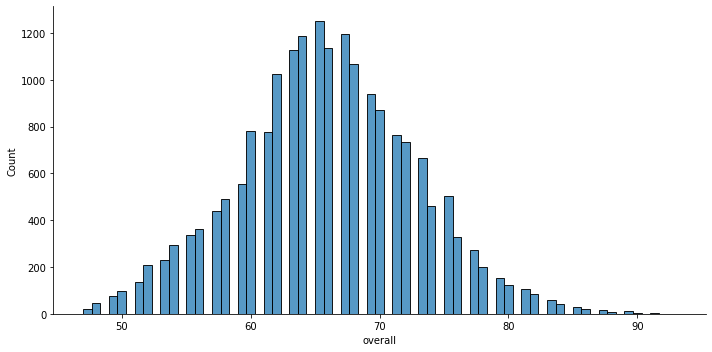

In [7]:
#070 Variable OVERALL (rendimiento global), 
#histograma de cantidad de jugadores con esa valoracion
sns.displot(df['overall'], stat='count', aspect=2)

count    19239.0
mean        65.8
std          6.9
min         47.0
25%         61.0
50%         66.0
75%         70.0
max         93.0
Name: overall, dtype: object


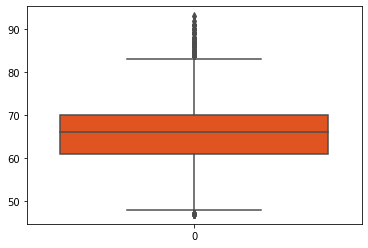

In [8]:
#080 Boxplot de OVERALL (rendimiento global)
#Identificacion rapida de los rangos de valores de lo jugadores
#para luego filtrar los de menor valor segun creiterio seleccionado de 
#esta tabla y tambien ver a partir de que rango se pueden considerar
#"estrellas" segun sean outliers
print(df['overall'].describe().apply("{0:.1f}".format))
sns.boxplot(data=df['overall'], color='orangered')

Mejores jugadores por posición:

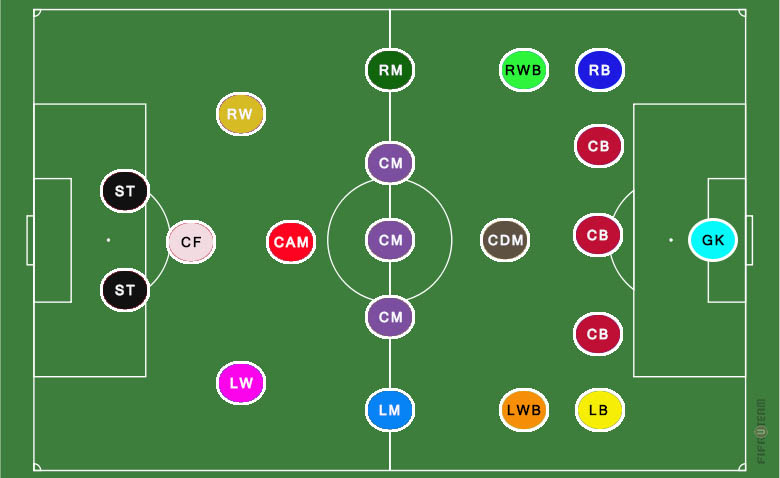

POSICIONES:

GK	Goalkeeper

RB	Right Back

CB	Center Back

LB	Left Back

RWB	Right Wing Back

LWB	Left Wing Back

CDM	Center Defensive Midfielder

CM	Center Midfielder

CAM	Center Attacking Midfielder

RM	Right Midfielder

LM	Left Midfielder

RW	Right Wing

LW	Left Wing

CF	Center Forward

ST	Striker


In [9]:
#090 Identificamos a los mejores jugadores por posicion
#NOTA: algunos juegan en varias posiciones, por lo que se evaluan en cada una de ellas

#En esta 1ra etapa, seleccionamos las distintas posiciones (y contamos
#cuantos jugadores juegan en esa posicion)

posiciones_unicas = df["player_positions"].str.split(',').explode().str.strip().unique().tolist()
cantidad_de_jugadores_por_posicion = df["player_positions"].str.split(',').explode().str.strip().value_counts()
cantidad_de_jugadores_por_posicion

CM     4204
CB     4021
ST     3398
CDM    3014
LM     2521
RM     2435
CAM    2260
GK     2132
RB     2132
LB     2101
RW     1172
LW     1154
LWB     492
RWB     457
CF      452
Name: player_positions, dtype: int64

In [10]:
#100 Identificamos a los mejores jugadores por posicion
#NOTA: algunos juegan en varias posiciones, por lo que se evaluan en cada una de ellas
#En esta 2da etapa, seleccionamos los mejores jugadores por posicion

mejores_jugadores_por_posicion = {}
for posicion in posiciones_unicas:
  mejores_jugadores_por_posicion[posicion]= {"jugador" : "", "overall" : 0}

for row in df.itertuples():
  _jugador = str(row.short_name)
  _overall = int(row.overall)
  for posicion in row.player_positions.split(','):
    posicion = posicion.strip()
    if _overall > mejores_jugadores_por_posicion[posicion]["overall"]:
      mejores_jugadores_por_posicion[posicion]= {"jugador" : _jugador, "overall" : _overall}

for posicion in posiciones_unicas:
  print("POSICION:", posicion, 
        ", OVERALL:", mejores_jugadores_por_posicion[posicion]["overall"],
        ", JUGADOR:", mejores_jugadores_por_posicion[posicion]["jugador"])

POSICION: RW , OVERALL: 93 , JUGADOR: L. Messi
POSICION: ST , OVERALL: 93 , JUGADOR: L. Messi
POSICION: CF , OVERALL: 93 , JUGADOR: L. Messi
POSICION: LW , OVERALL: 91 , JUGADOR: Cristiano Ronaldo
POSICION: CAM , OVERALL: 91 , JUGADOR: Neymar Jr
POSICION: CM , OVERALL: 91 , JUGADOR: K. De Bruyne
POSICION: GK , OVERALL: 91 , JUGADOR: J. Oblak
POSICION: CDM , OVERALL: 90 , JUGADOR: N. Kanté
POSICION: LM , OVERALL: 89 , JUGADOR: H. Son
POSICION: CB , OVERALL: 89 , JUGADOR: V. van Dijk
POSICION: RB , OVERALL: 89 , JUGADOR: J. Kimmich
POSICION: RM , OVERALL: 87 , JUGADOR: T. Müller
POSICION: LB , OVERALL: 87 , JUGADOR: A. Robertson
POSICION: RWB , OVERALL: 85 , JUGADOR: A. Hakimi
POSICION: LWB , OVERALL: 84 , JUGADOR: F. Kostić


Mejores Promedios de Overall por equipos

In [11]:
#110 Se agrupan los mejores promedios de Overall por equipos 
club_avg_overall=df.groupby("club_name")["overall"].mean().reset_index().sort_values("overall",ascending=False)
club_avg_overall.head(8)

,club_name,overall
368,Juventus,79.961538
470,Paris Saint-Germain,79.454545
358,Inter,78.857143
241,FC Bayern München,78.071429
412,Manchester United,78.000000
509,Real Madrid CF,77.757576
434,Napoli,77.500000
63,Atalanta,77.480000


Resumen general:
El dataset se compone por distintos grupos de variables:
* Datos personales del jugador (altura, peso, nacionalidad, etc)
* Datos económicos (valor del jugador, salario, etc)
* Datos relacionados al club (fecha de ingreso, contrato, número de camiseta, etc)
* Dos variables de puntaje general (resumen de otras variables de habilidad: Overall y Potential)
* Habilidades generales (attacking, passing, etc)  
* Posiciones en que juega
 

--------------------------------------------------------------------------------
## **CONSIGNA 2** - Evaluación visual e intuitiva de a dos variables numéricas por vez. 

In [12]:
#120 Para graficar de a dos variables, y que las variables sean comparativas entre sí, 
# se toman las variables relacionadas a la habilidad del jugador

skills_ratings = [['attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing', 'attacking_volleys'], 
                  ['skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control'], 
                  ['movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_reactions', 'movement_balance'],
                  ['power_shot_power', 'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots'],
                  ['mentality_aggression', 'mentality_interceptions', 'mentality_positioning', 'mentality_vision', 'mentality_penalties', 'mentality_composure'],
                  ['defending_marking_awareness', 'defending_standing_tackle', 'defending_sliding_tackle'],
                  ['goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning', 'goalkeeping_reflexes']]



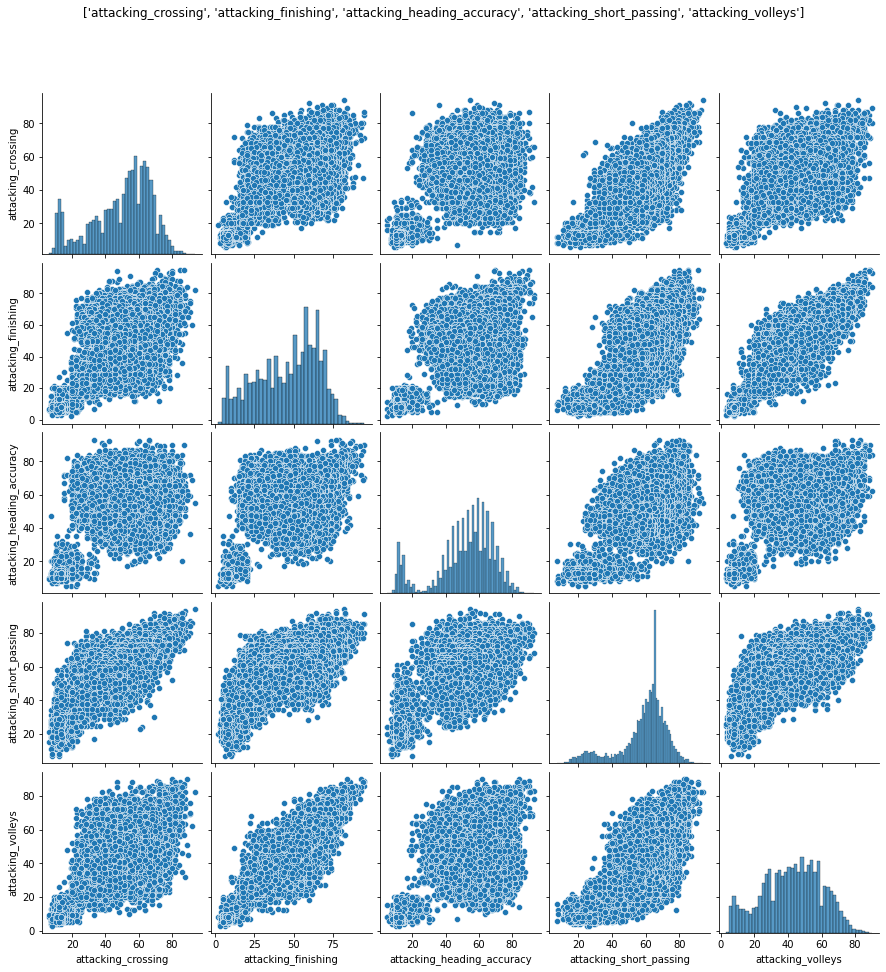

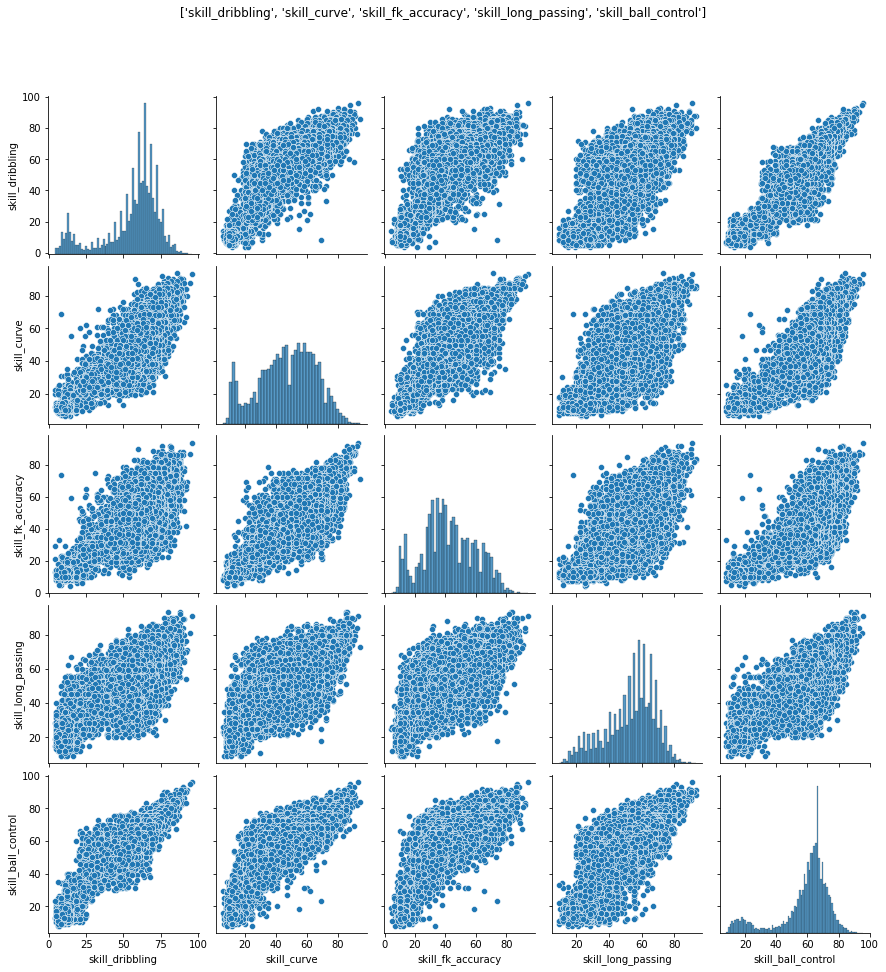

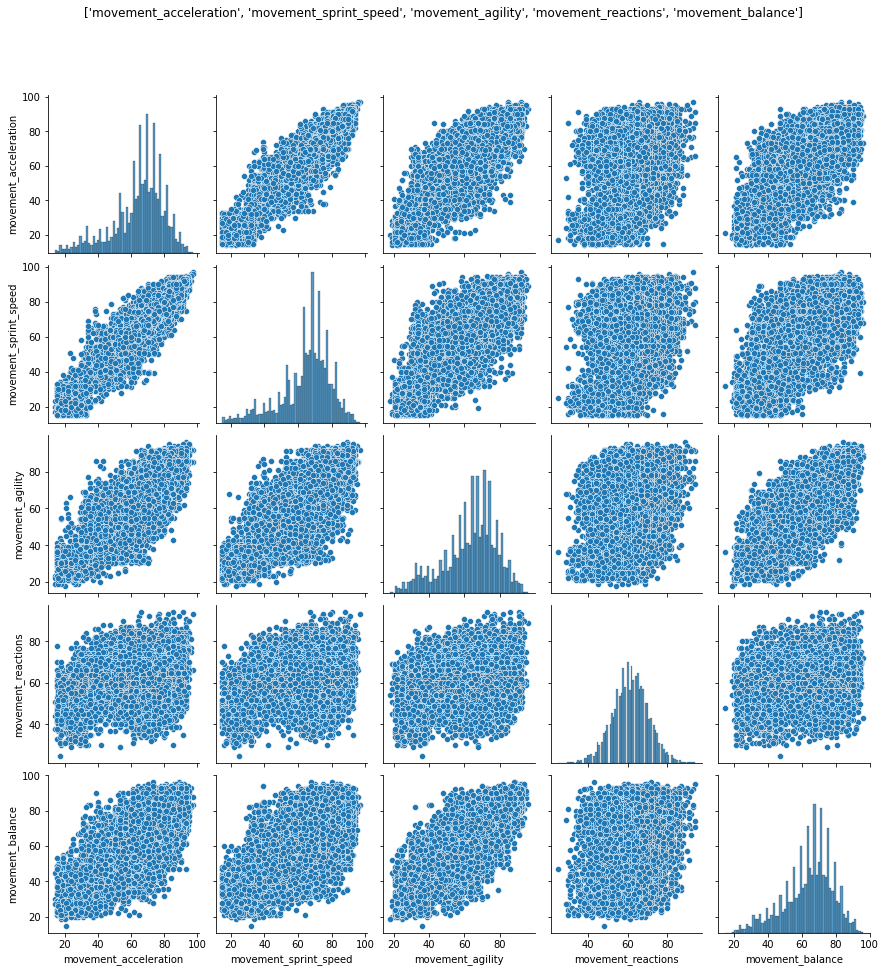

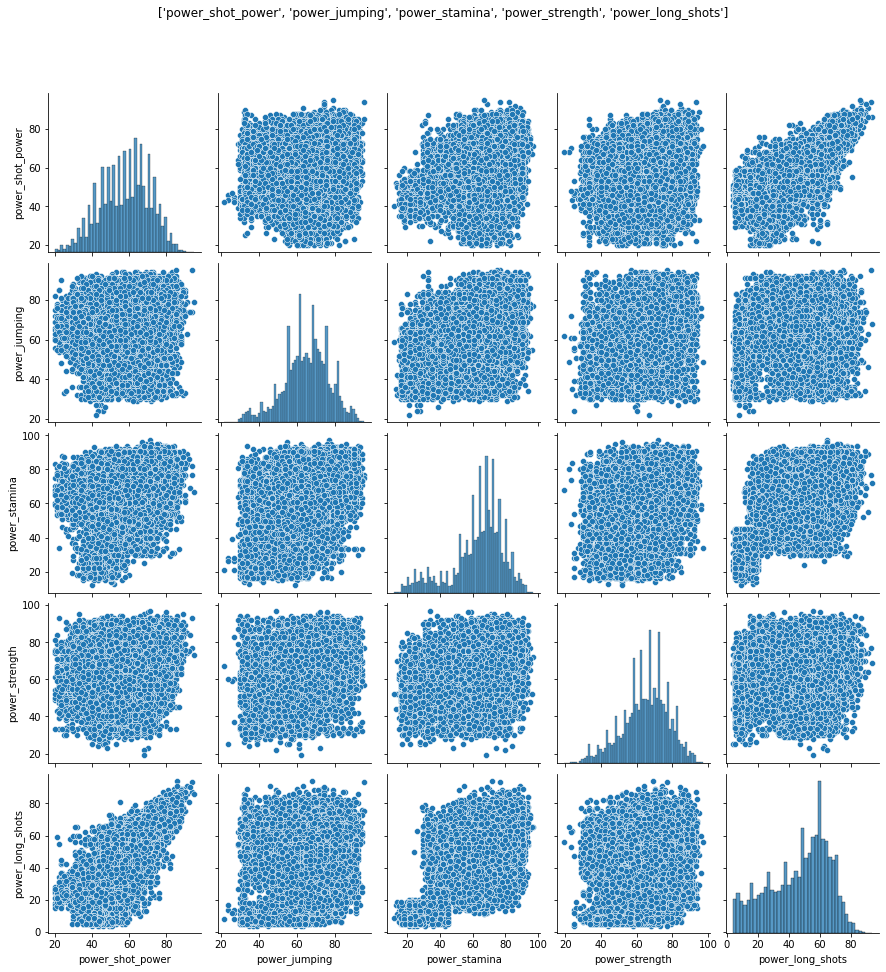

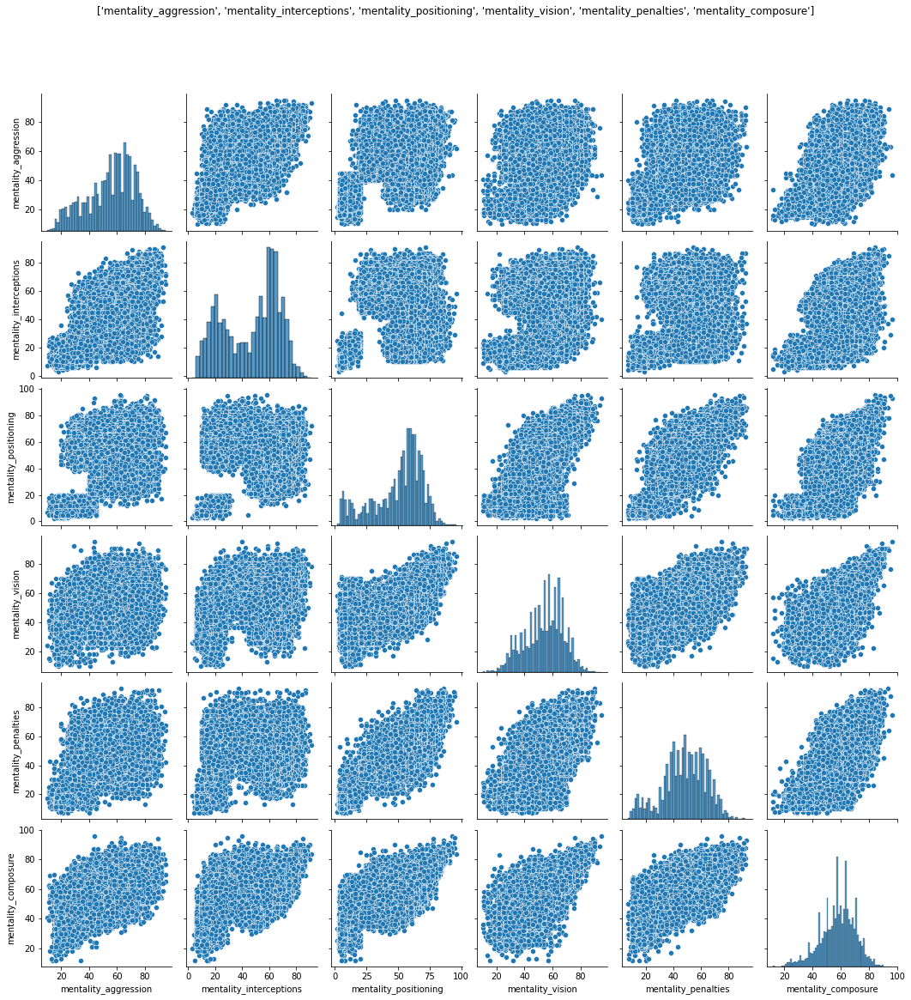

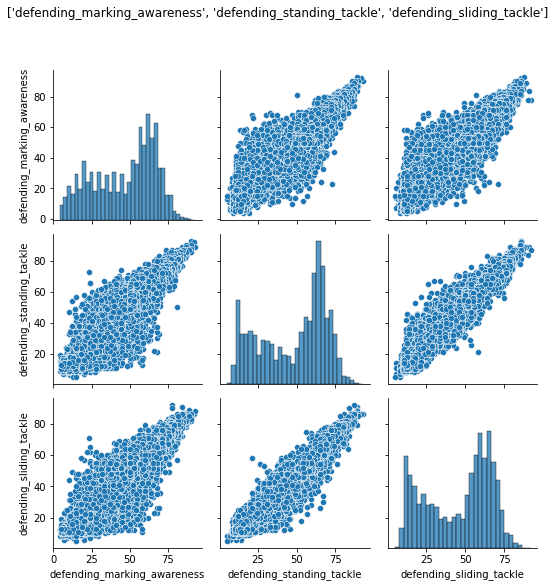

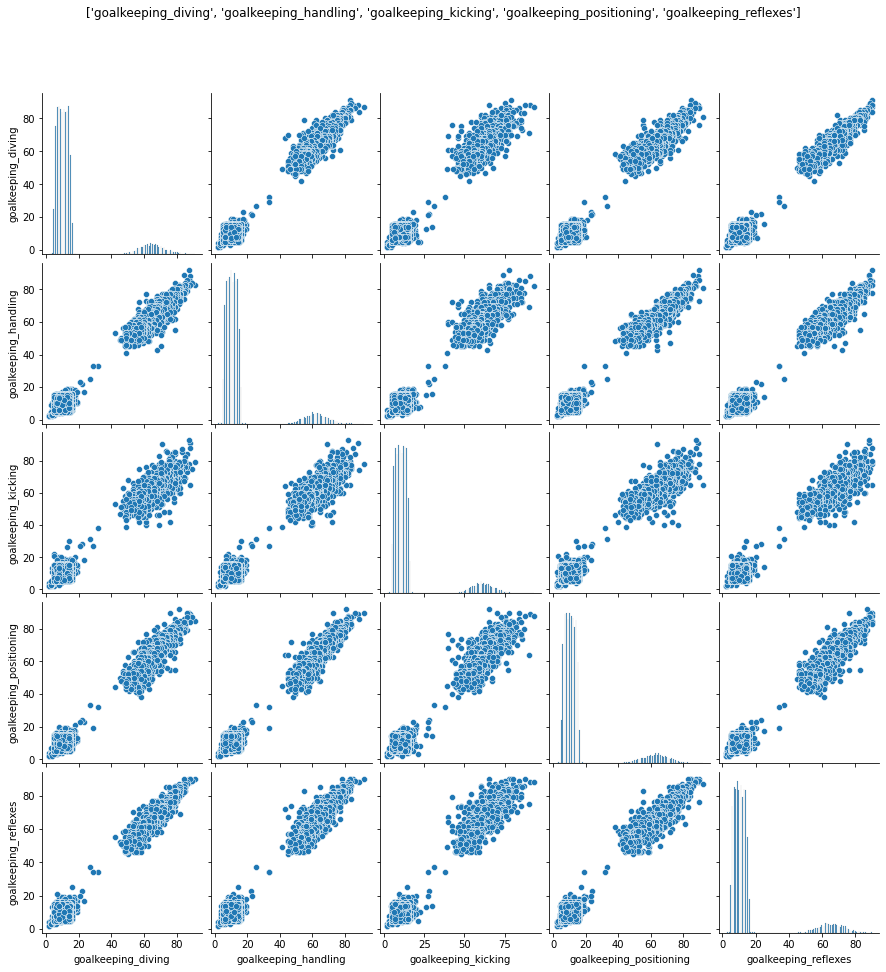

In [13]:
# 130 Graficamos lo indicado en el punto anterior (se comparan agrupados por tipo de habilidad)
# NOTA: tarda varios minutos en ejecutar

for subgrupo in skills_ratings:
  g = sns.pairplot(df[subgrupo])
  g.fig.suptitle(subgrupo, y=1.08) 
  #sns.pairplot(df[subgrupo], title=subgrupo)

**CONCLUSION:**

Se visualizan en todos los graficos uno o dos grupos.

Como no podemos extraer información relevante, vamos a incorporar la posición de juego, para ver si existen agrupaciones que aporten más información.


In [14]:
#140 Agrupamos las posiciones de juego por zona en la cancha
# Utilizamos una copia del dataframe por seguridad

forwards=['RF', 'ST', 'LW', 'LF', 'RS', 'LS', 'RW', 'CF']
midfielders=[ 'RM', 'LM','RCM', 'LCM', 'LDM', 'CAM', 'CDM', 'LAM', 'RDM', 'CM', 'RAM']
defenders=['RCB', 'CB', 'LCB', 'LB', 'RB', 'RWB', 'LWB']
goalkeepers=['GK']

dfcopy = df.copy()

In [15]:
#141 Agrupamos las posiciones de juego por zona en la cancha

def zona_de_juego(position_list):
    if any(forward in position_list for forward in forwards):
        return 'Forward' 
    elif any(midfielder in position_list for midfielder in midfielders):
        return 'Midfielder'   
    elif any(defender in position_list for defender in defenders): 
        return 'Defender'   
    elif any(goalkeeper in position_list for goalkeeper in goalkeepers):
        return 'GK'    
    else:
        return 'NaN'

dfcopy["zona_de_juego"] = dfcopy["player_positions"].apply(lambda x: zona_de_juego(x))

In [16]:
#150 Verificamos que el codigo se ejecute correctamente (no existan NaN) y
# vemos cuantos jugadores hay por zona
# NOTA: modificamos la funcion de agrupamiento utilizada en clase para que no se generen NaN
dfcopy["zona_de_juego"].value_counts()

Midfielder    6689
Forward       5762
Defender      4656
GK            2132
Name: zona_de_juego, dtype: int64

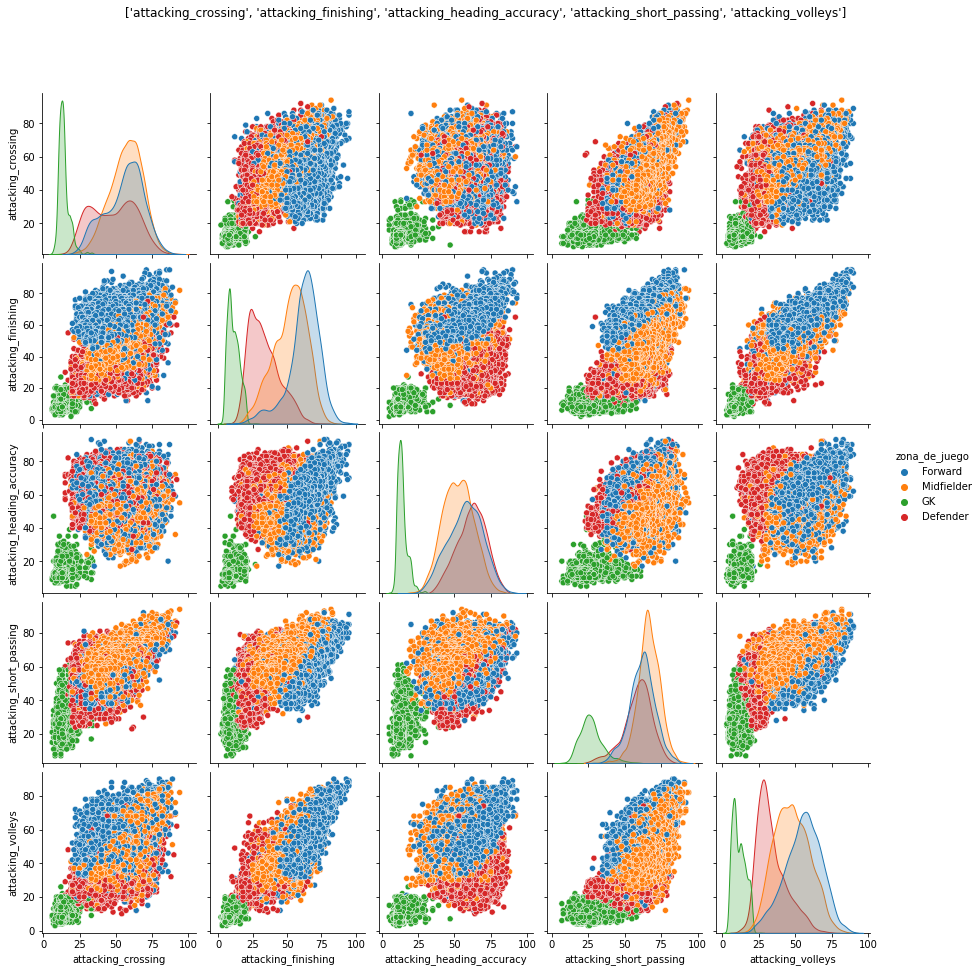

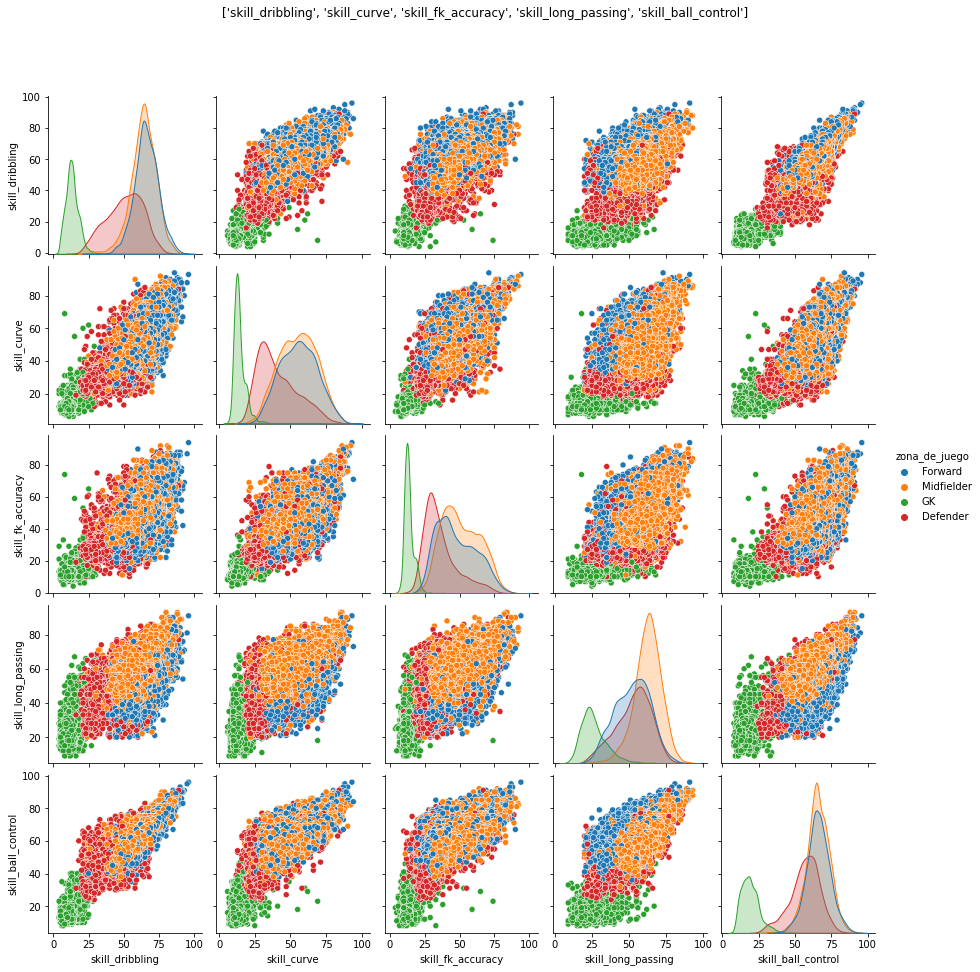

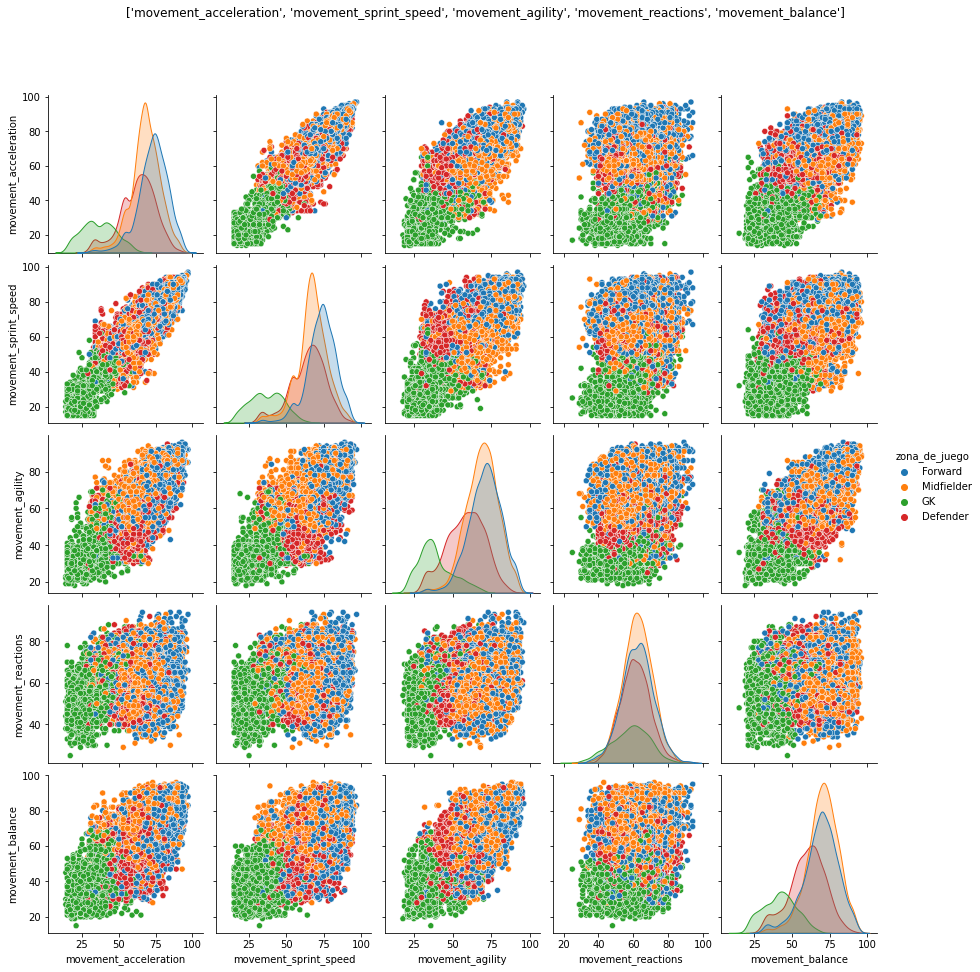

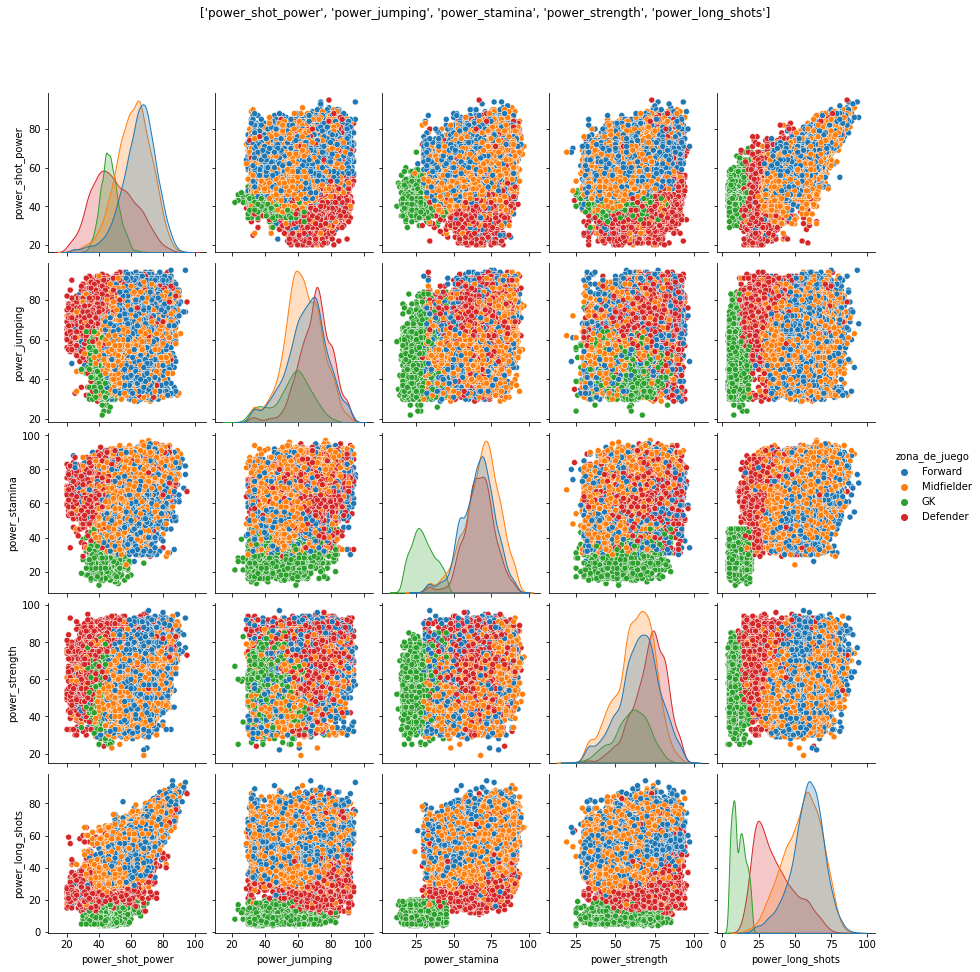

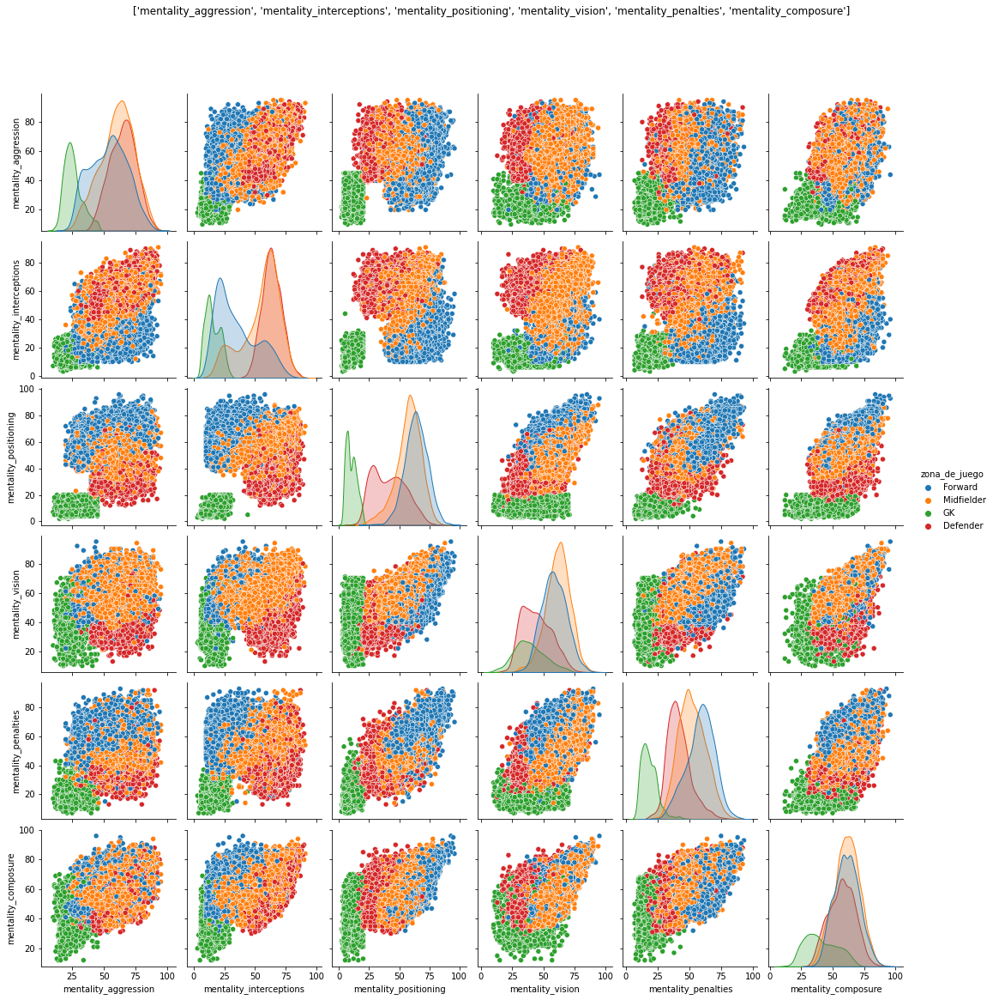

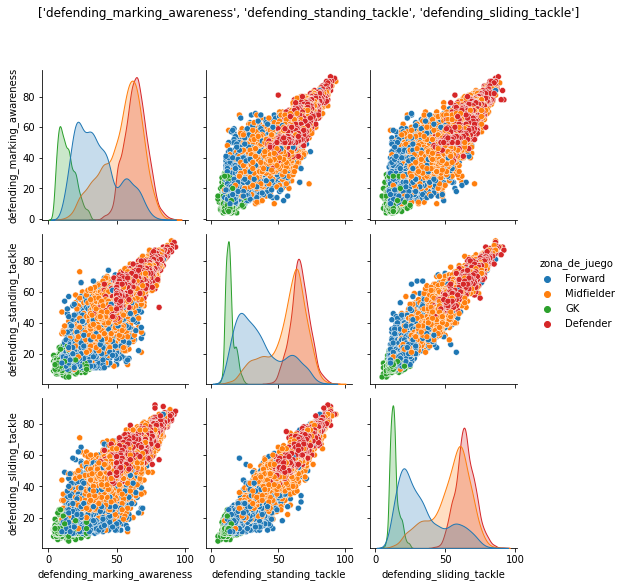

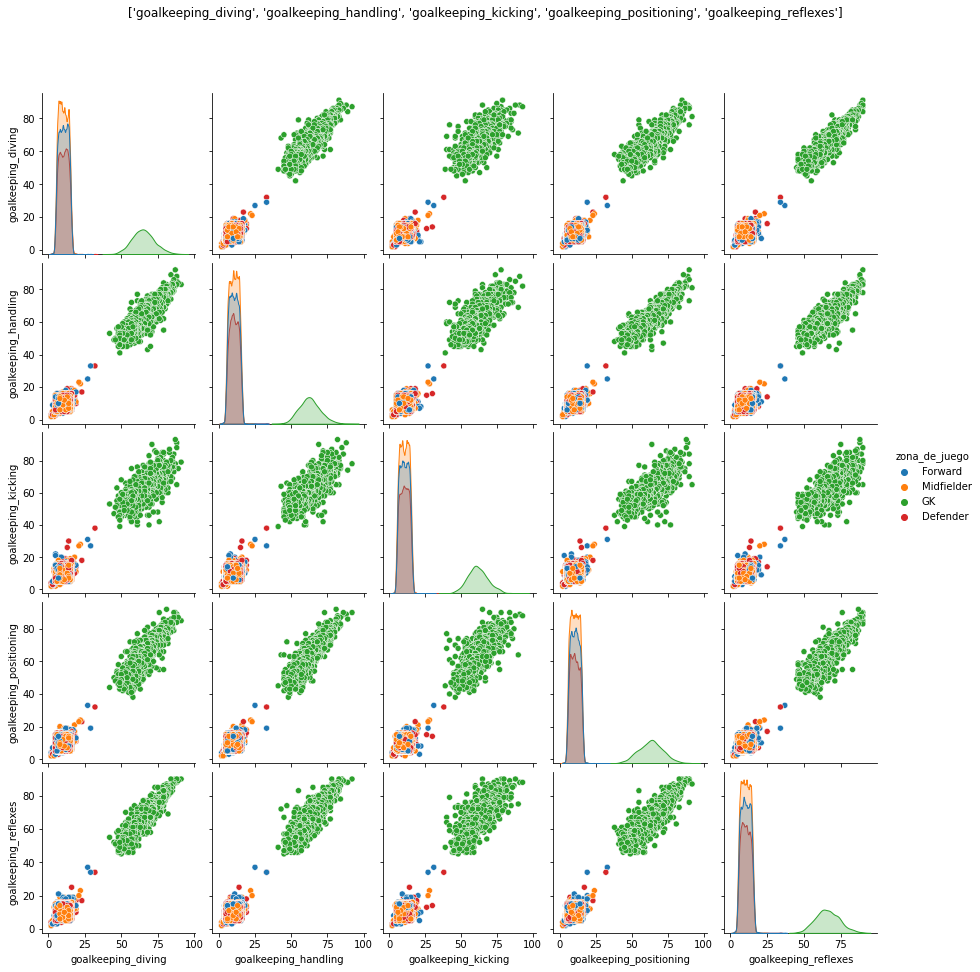

In [17]:
# 160 Graficamos lo indicado en el punto anterior (se comparan agrupados por tipo de habilidad)
# NOTA: tarda varios minutos en ejecutar

for subgrupo in skills_ratings:
  df_skills = dfcopy[subgrupo +['zona_de_juego']]

  g = sns.pairplot(df_skills, hue='zona_de_juego')
  g.fig.suptitle(subgrupo, y=1.08); 


**CONCLUSION:**

Ahora si es posible observar, en donde antes se veía un solo grupo, como este muestra diferencias de nivel de habilidad según zona de juego.

En donde antes se podían divisar dos grupos, ahora podemos saber que uno de esos grupos corresponden a los arqueros.


--------------------------------------------------------------------------------
## **CONSIGNA 3** - Uso de dos técnicas de clustering: por ejemplo, k-medias, DBSCAN, mezcla de Gaussianas y/o alguna jerárquica. Elección justificada de hiper-parámetros.

##**3.1. Clustering-con-Kmeans**

Es necesario definirle la cantidad de grupos/clusters (n_clusters), es un hiperparámetro del algoritmo. 


In [18]:
#170 Seleccionamos los mejores jugadores y sus habilidades para analizarlos con K-Means

FILTRO_MEJORES_POR_OVERALL = 70 #Filtramos los mejores jugadores en base al score Overall seleccionado en 70 (sobre 100)
df_mejores = dfcopy[dfcopy['overall'] > FILTRO_MEJORES_POR_OVERALL] 

skills2_ratings = ['attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing', 'attacking_volleys', 
                  'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control', 
                  'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_reactions', 'movement_balance',
                  'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
                  'mentality_aggression', 'mentality_interceptions', 'mentality_positioning', 'mentality_vision', 'mentality_penalties', 'mentality_composure',
                  'defending_marking_awareness', 'defending_standing_tackle', 'defending_sliding_tackle',
                  'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning', 'goalkeeping_reflexes']
df_skills2 = df_mejores[skills2_ratings]
df_skills2.shape

(4593, 34)

Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

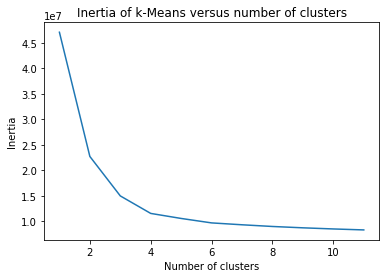

In [19]:
#180 Elección del hiperparámetro n_clusters para KMeans
#Evaluamos con el metodo del codo, para elegir la cantidad de clusters para Kmeans
scores = [KMeans(n_clusters=i).fit(df_skills2).inertia_ for i in range(1, 12)]
plt.plot(np.arange(1, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

In [20]:
#190 Del gráfico anterior elegimos la cantidad de clusters igual a 4 porque vemos que es donde la pendiente pierde fuerza, y los siguientes
# valores ya no tienen tanta diferencia de pendiente.
N_CLUSTERS_PARA_KMEANS = 4

In [21]:
#200 Aplicación de Clustering-con-Kmeans

km = KMeans(n_clusters=N_CLUSTERS_PARA_KMEANS)
km.fit(df_skills2) #utiliza todas las habilidades: 34 dimensiones
#km.fit(dfcopy) #utiliza todas las habilidades: 34 dimensiones

# Etiquetas asignadas por el algoritmo
clusters = km.labels_
#print('Suma de los cuadrados de las distancias al centro de cada cluster=Inertia= ', km.inertia_)

In [22]:
#210 Agregamos la columna con las etiquetas de los clusters encontrados

df_clusters_Km = df_skills2.copy()
df_clusters_Km['kmeans_4'] = km.labels_ #clusters
df_mejores['kmeans_4'] = km.labels_ #clusters
print('Kmeans encontró: ', max(km.labels_)+1, 'clusters, nosotros forzamos la cantidad')
df_clusters_Km.head(10)

Kmeans encontró:  4 clusters, nosotros forzamos la cantidad


,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,kmeans_4
0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,2
1,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,2
2,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,2
3,85,83,63,86,86,95,88,87,81,95,93,89,96,89,84,80,64,81,53,81,63,37,86,90,93,93,35,32,29,9,9,15,15,11,2
4,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,3
5,13,11,15,43,13,12,13,14,40,30,43,60,67,88,49,59,78,41,78,12,34,19,11,65,11,68,27,12,18,87,92,78,90,90,1
6,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,2
7,15,13,25,60,11,30,14,11,68,46,54,60,51,87,35,68,77,43,80,16,29,30,12,70,47,70,17,10,11,88,88,91,89,88,1
8,18,14,11,61,14,21,18,12,63,30,38,50,39,86,43,66,79,35,78,10,43,22,11,70,25,70,25,13,10,88,85,88,88,90,1
9,80,94,86,85,88,83,83,65,86,85,65,74,71,92,70,91,79,83,85,86,80,44,94,87,91,91,50,36,38,8,10,11,14,11,2


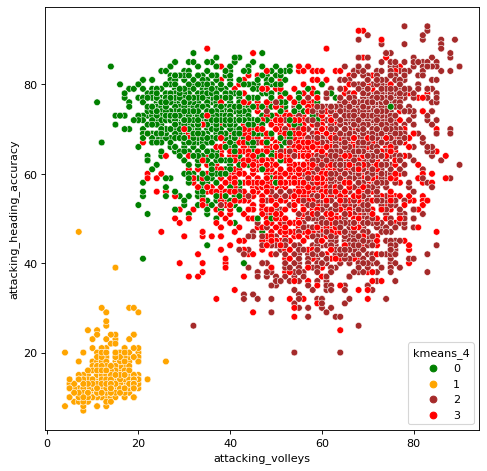

In [23]:
#220 Graficamos un par de variables para ver los clusters encontrados 
color ='kmeans_4'
skill_3 = 'attacking_volleys'
skill_4 = 'attacking_heading_accuracy'
plt.figure(figsize=(7,7), dpi=80)
sns.scatterplot(x = df_clusters_Km[skill_3], y = df_clusters_Km[skill_4], hue= df_clusters_Km[color], palette=['green','orange','brown','red'])

In [24]:
#230 Embeddings y Agrupamiento 
#Investigamos si con PCA se obtienen mejores resultados o no
#En principio investigamos la varianza explicada por cada componente principal y la acumulada

df_skills3 = df_skills2.copy()
standard_scaler = StandardScaler().fit_transform(df_skills3) #realiza la tarea de Estandarización

for i in range(1, 20):
  pca = PCA(n_components=i)
  pca_res = pca.fit(standard_scaler)
  print("componentes: {:d}, varianza: {:2.2f}%, varianza acumulada: {:2.2f}%".format(i, pca_res.explained_variance_ratio_[-1] * 100, pca_res.explained_variance_ratio_.sum() * 100))


componentes: 1, varianza: 54.43%, varianza acumulada: 54.43%
componentes: 2, varianza: 16.67%, varianza acumulada: 71.10%
componentes: 3, varianza: 6.18%, varianza acumulada: 77.29%
componentes: 4, varianza: 5.11%, varianza acumulada: 82.39%
componentes: 5, varianza: 3.81%, varianza acumulada: 86.21%
componentes: 6, varianza: 2.02%, varianza acumulada: 88.22%
componentes: 7, varianza: 1.64%, varianza acumulada: 89.87%
componentes: 8, varianza: 1.12%, varianza acumulada: 90.98%
componentes: 9, varianza: 0.95%, varianza acumulada: 91.93%
componentes: 10, varianza: 0.92%, varianza acumulada: 92.85%
componentes: 11, varianza: 0.80%, varianza acumulada: 93.65%
componentes: 12, varianza: 0.68%, varianza acumulada: 94.33%
componentes: 13, varianza: 0.66%, varianza acumulada: 95.00%
componentes: 14, varianza: 0.62%, varianza acumulada: 95.61%
componentes: 15, varianza: 0.56%, varianza acumulada: 96.18%
componentes: 16, varianza: 0.44%, varianza acumulada: 96.61%
componentes: 17, varianza: 0.42

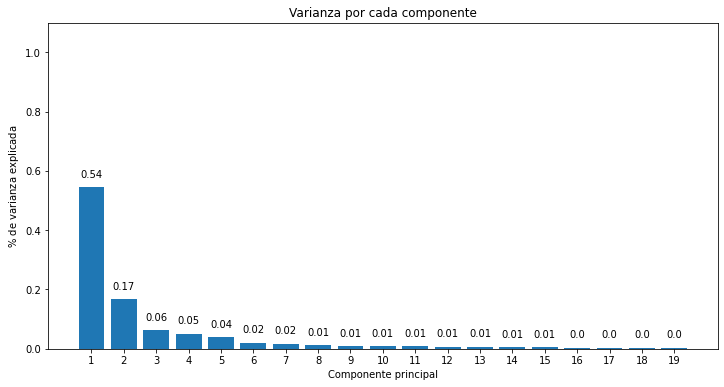

In [25]:
#240 Graficamos lo anterior
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 6))
ax.bar(
    x      = np.arange(pca_res.n_components_) + 1,
    height = pca_res.explained_variance_ratio_
)
for x, y in zip(np.arange(len(df_skills3.columns)) + 1, pca_res.explained_variance_ratio_):
    label = round(y, 2)
    ax.annotate(
        label,
        (x,y),
        textcoords="offset points",
        xytext=(0,10),
        ha='center'
    )

ax.set_xticks(np.arange(pca_res.n_components_) + 1)
ax.set_ylim(0, 1.1)
ax.set_title('Varianza por cada componente')
ax.set_xlabel('Componente principal')
ax.set_ylabel('$\%$ de varianza explicada');

In [26]:
#250 Seleccionamos 13 componentes para PCA porque explican el 95% de la varianza

N_COMPONENTS_PCA = 13

pca = PCA(n_components=N_COMPONENTS_PCA)
pca_res = pca.fit_transform(standard_scaler)

df_PCA = pd.DataFrame(pca_res)
df_PCA

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,-6.219911,-4.968117,1.749340,2.172998,-2.739439,-1.579935,0.804734,-0.502191,0.394009,0.980924,0.229840,0.591733,0.904499
1,-5.338508,-2.694372,3.858591,0.221552,-3.193187,-0.548163,0.415452,0.701587,-0.053279,0.126427,0.791206,0.122994,0.756333
2,-5.523053,-3.804024,3.391722,-0.135760,-4.019572,-0.536769,0.785896,0.555476,0.187380,1.230546,-0.024563,0.210150,-0.051237
3,-5.774590,-4.587582,0.539083,1.683706,-2.243186,-1.585509,0.769544,0.125478,-0.160314,0.713366,0.665028,0.243303,-0.402396
4,-6.223654,-1.734500,1.868029,3.361302,-1.999697,-0.665455,-0.775091,0.031685,0.373295,0.129435,0.387895,0.390257,0.071498
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4588,-0.328997,0.388806,-0.641781,1.247433,1.665479,-0.355304,1.132609,-0.788000,0.584860,0.118438,0.155574,0.332580,-0.915880
4589,-2.258135,0.865406,0.375748,0.490492,0.418263,0.744890,-0.653429,-0.232380,-0.488037,-0.073070,0.517001,-0.337502,-0.221929
4590,-0.135400,1.270315,-2.682153,-0.964425,1.105320,-0.036923,-0.256579,-1.742119,0.497689,0.959929,0.003330,-0.974594,-0.634756
4591,-0.251823,-1.408960,0.687713,-1.898421,0.512721,0.108046,-0.442407,0.736131,0.220995,-0.377380,-0.052333,-0.175585,0.699379


Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

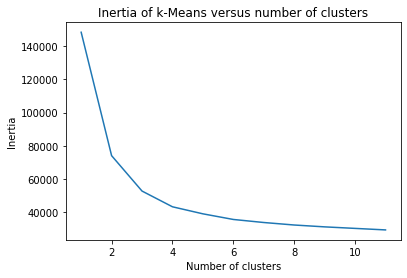

In [27]:
#260 Evaluamos con el metodo del codo, para elegir la cantidad de clusters para Kmeans con PCA

scores = [KMeans(n_clusters=i).fit(df_PCA).inertia_ for i in range(1, 12)]

plt.plot(np.arange(1, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

In [28]:
#270 Elegimos la cantidad de clusters 4 porque vemos que es donde la pendiente pierde fuerza, y los siguientes
# valores ya no tienen tanta diferencia de pendiente.

N_CLUSTERS_PARA_KMEANS = 4

In [29]:
#280 Clustering-con-Kmeans

km = KMeans(n_clusters=N_CLUSTERS_PARA_KMEANS)
clusters_Km_PCA = km.fit_transform(df_PCA) #utiliza 13 dimensiones

# Etiquetas asignadas por el algoritmo
clusters = km.labels_
#df_clusters_Km_PCA = pd.DataFrame(df_clusters_Km_PCA)
clusters_Km_PCA
len(clusters)

4593

In [30]:
#290 Agrego la columna con las etiquetas de los clusters encontrados

df_clusters_Km_PCA = df_PCA.copy()
df_clusters_Km_PCA['kmeans_PCA_4'] = km.labels_ #clusters
df_mejores['kmeans_PCA_4'] = km.labels_ #clusters
print('Kmeans encontró: ', max(km.labels_)+1, 'clusters, nosotros forzamos la cantidad')
df_clusters_Km_PCA.head(10)


Kmeans encontró:  4 clusters, nosotros forzamos la cantidad


,0,1,2,3,4,5,6,7,8,9,10,11,12,kmeans_PCA_4
0,-6.219911,-4.968117,1.749340,2.172998,-2.739439,-1.579935,0.804734,-0.502191,0.394009,0.980924,0.229840,0.591733,0.904499,1
1,-5.338508,-2.694372,3.858591,0.221552,-3.193187,-0.548163,0.415452,0.701587,-0.053279,0.126427,0.791206,0.122994,0.756333,1
2,-5.523053,-3.804024,3.391722,-0.135760,-4.019572,-0.536769,0.785896,0.555476,0.187380,1.230546,-0.024563,0.210150,-0.051237,1
3,-5.774590,-4.587582,0.539083,1.683706,-2.243186,-1.585509,0.769544,0.125478,-0.160314,0.713366,0.665028,0.243303,-0.402396,1
4,-6.223654,-1.734500,1.868029,3.361302,-1.999697,-0.665455,-0.775091,0.031685,0.373295,0.129435,0.387895,0.390257,0.071498,3
5,11.328324,-1.937119,0.829097,2.497243,-4.690930,-0.588180,-0.584120,-1.008063,-0.030395,0.125086,0.054524,0.283520,0.535552,0
6,-5.540063,-3.698166,1.545024,-0.162562,-3.669061,-1.666673,-0.325078,0.197700,0.311500,0.250119,0.367738,0.347229,0.186025,1
7,9.886343,-2.172878,2.063575,2.858100,-4.284210,-0.722227,-0.801143,-1.876120,0.824685,1.143433,-0.154858,1.744554,-0.033128,0
8,10.828517,-1.629406,2.191161,3.442418,-3.812332,-0.177883,-0.275831,-1.796031,0.419874,0.446138,-0.366653,0.799526,0.673160,0
9,-5.273890,-2.009699,4.222916,1.178704,-2.622174,-0.749121,0.120390,-0.076738,0.443209,-0.089538,0.305808,0.016357,0.049046,1


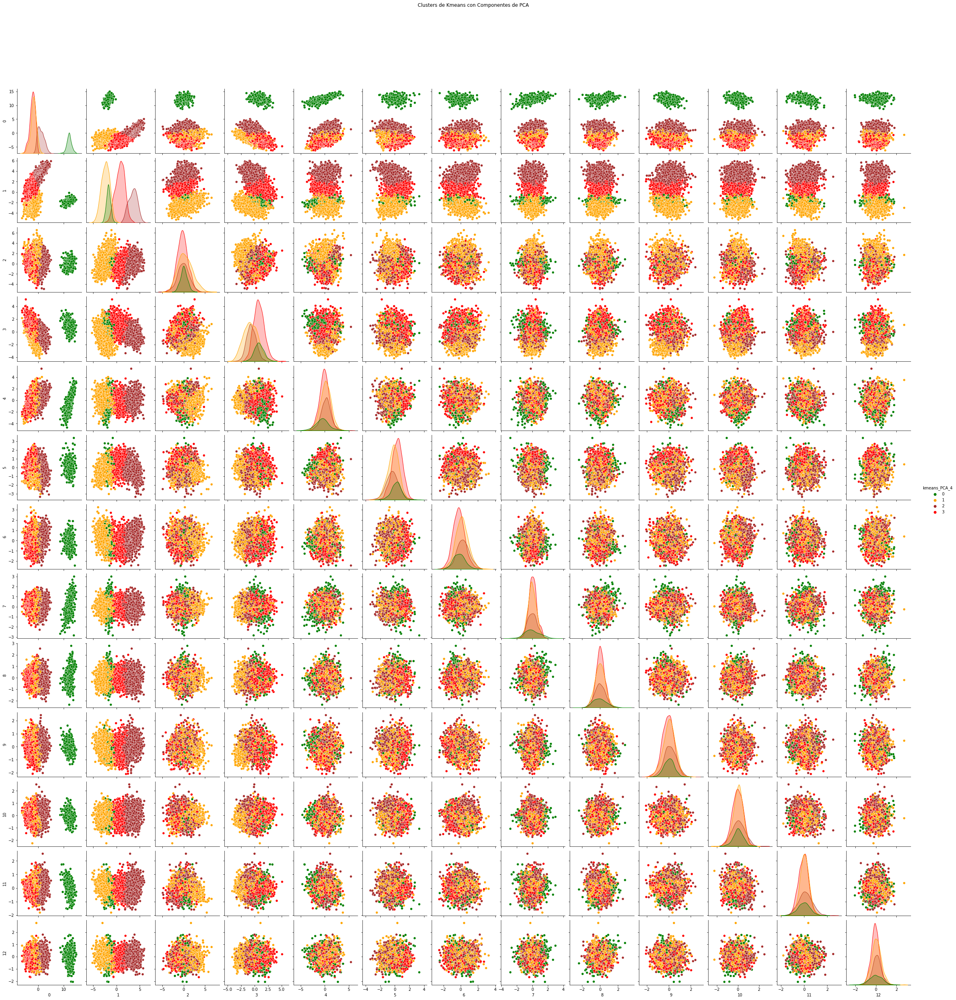

In [31]:
#300 Graficamos de a pares los clusters de Kmeans que se formaron por las componentes de PCA
#NOTA: el procesamiento tarda unos minutos
g = sns.pairplot(df_clusters_Km_PCA, hue='kmeans_PCA_4', palette=['green','orange','brown','red'])
g.fig.suptitle('Clusters de Kmeans con Componentes de PCA', y=1.08); 

**Del gráfico anterior podemos ver que se separan mejor los clusters en el conjunto de componentes con más varianza.**

Arriba a la izquierda partiendo de la componente 0 están las variables con mayor varianza y donde más se separan los clusters.
Abajo a la derecha en la componente 12 tenemos la de menor varianza y donde menos se separan los clusters.


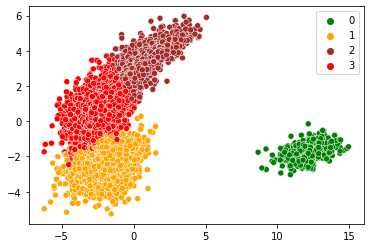

In [32]:
#310 Hacemos zoom en el grafico de las 2 componentes con mas varianza
sns.scatterplot(x = pca_res[:,0], y = pca_res[:,1], hue= km.labels_, palette=['green','orange','brown','red'])

## 3.2. Clustering Mezcla de Gaussianas


In [33]:
#320 Como vemos que los arqueros se separan notablemente del resto, 
# los quitamos para hacer el análisis de Mezcla de Gaussianas y su PCA,
# ya que pueden influir en la elección de componentes principales

#df_best_without_gk = df_mejores.copy()
#df_best_without_gk.drop(df_best_without_gk.loc[df_best_without_gk['player_positions']=='GK'].index, axis=0, inplace=True)
#df_best_without_gk_skills = df_best_without_gk[skills2_ratings]
#df_best_without_gk_skills

Text(0.5, 1.0, 'BIC versus number of components')

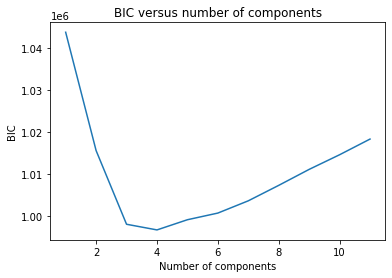

In [34]:
#320 Evaluamos con el metodo del codo, 
# para elegir la cantidad de clusters para Mezcla de Gaussianas
# Se usa la funcion BIC (Bayesian information criterion for the current model on the input X).

# NOTA: recordamos que df_skill2 es:
# Habilidades de los mejores jugadores, en base al score Overall mayor a 70 (sobre 100)
# Celda 170

scores = [GaussianMixture(n_components=i).fit(df_skills2).bic(df_skills2) for i in range(1, 12)]
plt.plot(np.arange(1, 12), scores)
plt.xlabel('Number of components')
plt.ylabel("BIC")
plt.title("BIC versus number of components")

In [35]:
#330 Elegimos la cantidad de clusters 4 porque vemos que es donde esta el 
# mejor criterio de información (menor es mejor).
N_CLUSTERS_PARA_GM = 4

In [36]:
#340 Clustering con GaussianMixture
gm = GaussianMixture(n_components=N_CLUSTERS_PARA_GM, verbose=2, verbose_interval=2)
gm.fit(df_skills2) #utiliza todas las habilidades: 34 dimensiones

Initialization 0
  Iteration 2	 time lapse 0.07143s	 ll change 0.11917
  Iteration 4	 time lapse 0.03425s	 ll change 0.01416
  Iteration 6	 time lapse 0.03091s	 ll change 0.00480
  Iteration 8	 time lapse 0.03098s	 ll change 0.00185
  Iteration 10	 time lapse 0.03205s	 ll change 0.00078
Initialization converged: True	 time lapse 0.20036s	 ll -106.19802


GaussianMixture(n_components=4, verbose=2, verbose_interval=2)

In [37]:
#350 Agrego la columna con las etiquetas de los clusters encontrados

gm_result = gm.predict(df_skills2) #utiliza todas las habilidades: 34 dimensiones
df_clusters_Gm = df_skills2.copy()
df_clusters_Gm['gm_4'] = gm_result
print('GaussianMixture encontró: ', max(gm_result)+1, 'clusters, nosotros forzamos la cantidad')
df_clusters_Gm.head(10)

GaussianMixture encontró:  4 clusters, nosotros forzamos la cantidad


,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,gm_4
0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,3
1,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,3
2,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,3
3,85,83,63,86,86,95,88,87,81,95,93,89,96,89,84,80,64,81,53,81,63,37,86,90,93,93,35,32,29,9,9,15,15,11,3
4,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,3
5,13,11,15,43,13,12,13,14,40,30,43,60,67,88,49,59,78,41,78,12,34,19,11,65,11,68,27,12,18,87,92,78,90,90,1
6,78,93,72,85,83,93,80,69,71,91,97,97,92,93,83,86,78,88,77,82,62,38,92,82,79,88,26,34,32,13,5,7,11,6,3
7,15,13,25,60,11,30,14,11,68,46,54,60,51,87,35,68,77,43,80,16,29,30,12,70,47,70,17,10,11,88,88,91,89,88,1
8,18,14,11,61,14,21,18,12,63,30,38,50,39,86,43,66,79,35,78,10,43,22,11,70,25,70,25,13,10,88,85,88,88,90,1
9,80,94,86,85,88,83,83,65,86,85,65,74,71,92,70,91,79,83,85,86,80,44,94,87,91,91,50,36,38,8,10,11,14,11,3


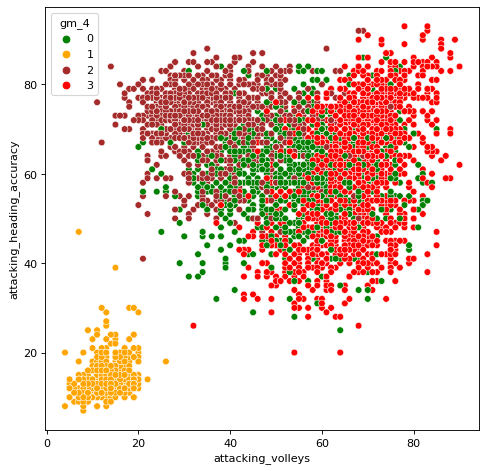

In [38]:
#360 Graficamos un par de variables para ver los clusters encontrados 
color ='gm_4'
skill_3 = 'attacking_volleys'
skill_4 = 'attacking_heading_accuracy'
plt.figure(figsize=(7,7), dpi=80)
sns.scatterplot(x = df_clusters_Gm[skill_3], y = df_clusters_Gm[skill_4], hue= df_clusters_Gm[color], palette=['green','orange','brown','red'])

In [39]:
#370 Embeddings y Agrupamiento 
#Investigamos si con PCA (antes de GaussianMixture) si se obtienen mejores resultados o no
#En principio investigamos la varianza explicada por cada componente principal y la acumulada

df_skills4 = df_skills2.copy()

standard_scaler = StandardScaler().fit_transform(df_skills4)

for i in range(1, 20):
  pca = PCA(n_components=i)
  pca_res = pca.fit(standard_scaler)
  print("componentes: {:d}, varianza: {:2.2f}%, varianza acumulada: {:2.2f}%".format(i, pca_res.explained_variance_ratio_[-1] * 100, pca_res.explained_variance_ratio_.sum() * 100))


componentes: 1, varianza: 54.43%, varianza acumulada: 54.43%
componentes: 2, varianza: 16.67%, varianza acumulada: 71.10%
componentes: 3, varianza: 6.18%, varianza acumulada: 77.29%
componentes: 4, varianza: 5.11%, varianza acumulada: 82.39%
componentes: 5, varianza: 3.81%, varianza acumulada: 86.21%
componentes: 6, varianza: 2.02%, varianza acumulada: 88.22%
componentes: 7, varianza: 1.64%, varianza acumulada: 89.87%
componentes: 8, varianza: 1.12%, varianza acumulada: 90.98%
componentes: 9, varianza: 0.95%, varianza acumulada: 91.93%
componentes: 10, varianza: 0.92%, varianza acumulada: 92.85%
componentes: 11, varianza: 0.80%, varianza acumulada: 93.65%
componentes: 12, varianza: 0.68%, varianza acumulada: 94.33%
componentes: 13, varianza: 0.66%, varianza acumulada: 95.00%
componentes: 14, varianza: 0.62%, varianza acumulada: 95.61%
componentes: 15, varianza: 0.56%, varianza acumulada: 96.18%
componentes: 16, varianza: 0.44%, varianza acumulada: 96.61%
componentes: 17, varianza: 0.42

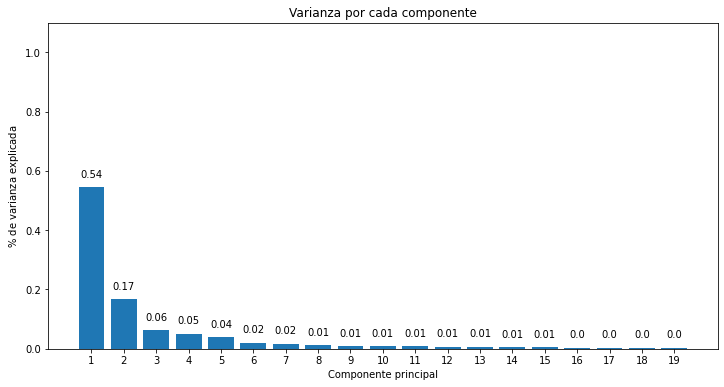

In [40]:
#380 Graficamos lo anterior

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 6))
ax.bar(
    x      = np.arange(pca_res.n_components_) + 1,
    height = pca_res.explained_variance_ratio_
)

for x, y in zip(np.arange(len(df_skills4.columns)) + 1, pca_res.explained_variance_ratio_):
    label = round(y, 2)
    ax.annotate(
        label,
        (x,y),
        textcoords="offset points",
        xytext=(0,10),
        ha='center'
    )

ax.set_xticks(np.arange(pca_res.n_components_) + 1)
ax.set_ylim(0, 1.1)
ax.set_title('Varianza por cada componente')
ax.set_xlabel('Componente principal')
ax.set_ylabel('$\%$ de varianza explicada');

In [41]:
#390 Seleccionamos 13 componentes para PCA porque explican el 95% de la varianza

N_COMPONENTS_PCA = 13

pca = PCA(n_components=N_COMPONENTS_PCA)
pca_res = pca.fit_transform(standard_scaler)

df_PCA = pd.DataFrame(pca_res)
df_PCA

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,-6.219911,-4.968117,1.749340,2.172997,-2.739439,-1.580009,0.804497,-0.502351,0.394023,0.981220,0.231796,0.587802,0.904514
1,-5.338508,-2.694372,3.858591,0.221552,-3.193186,-0.548155,0.415408,0.701534,-0.053110,0.126923,0.791044,0.123271,0.754916
2,-5.523053,-3.804024,3.391723,-0.135761,-4.019576,-0.536788,0.785971,0.555436,0.189243,1.231874,-0.025446,0.211045,-0.044238
3,-5.774590,-4.587582,0.539083,1.683706,-2.243188,-1.585539,0.769354,0.125252,-0.161256,0.712927,0.666476,0.242147,-0.406065
4,-6.223654,-1.734500,1.868029,3.361302,-1.999696,-0.665442,-0.775049,0.031756,0.373320,0.129200,0.387395,0.390922,0.071540
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4588,-0.328997,0.388806,-0.641782,1.247435,1.665488,-0.355310,1.132565,-0.787534,0.584086,0.118545,0.156548,0.330809,-0.926101
4589,-2.258135,0.865406,0.375748,0.490492,0.418261,0.744869,-0.653500,-0.232499,-0.488123,-0.072769,0.517805,-0.338638,-0.221865
4590,-0.135400,1.270315,-2.682152,-0.964426,1.105320,-0.036854,-0.256163,-1.741746,0.500030,0.960909,0.000417,-0.973633,-0.625382
4591,-0.251823,-1.408960,0.687713,-1.898422,0.512723,0.108022,-0.442247,0.736533,0.222549,-0.376872,-0.052468,-0.179816,0.705919


Text(0.5, 1.0, 'BIC of GaussianMixture versus number of components')

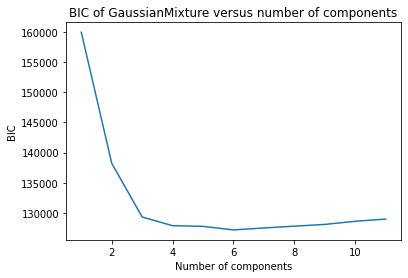

In [42]:
from pandas.core.common import random_state
#400 Evaluamos con el metodo del codo, para elegir la cantidad de clusters para GaussianMixture con PCA

scores = [GaussianMixture(n_components=i, random_state=1).fit(df_PCA).bic(df_PCA) for i in range(1, 12)]

plt.plot(np.arange(1, 12), scores)
plt.xlabel('Number of components')
plt.ylabel("BIC")
plt.title("BIC of GaussianMixture versus number of components")

In [43]:
#410 Verificamos numericamente para la seleccion (entre 4 y 6)
for component, valor in enumerate(scores):
  print("componente:", component+1, ", valor:", valor) 

componente: 1 , valor: 159922.8297602456
componente: 2 , valor: 138235.18884612943
componente: 3 , valor: 129347.65692973006
componente: 4 , valor: 127908.39218942108
componente: 5 , valor: 127796.85132664119
componente: 6 , valor: 127208.78100694154
componente: 7 , valor: 127531.84653116914
componente: 8 , valor: 127830.1089363107
componente: 9 , valor: 128120.21527521785
componente: 10 , valor: 128634.80533851947
componente: 11 , valor: 129006.2013236713


In [44]:
#420 Elegimos la cantidad de clusters 5 porque vemos que es donde esta el 
# mejor criterio de información (menor es mejor).
N_CLUSTERS_PARA_GM = 5

In [45]:
#430 Clustering con GaussianMixture con PCA

gm = GaussianMixture(n_components=N_CLUSTERS_PARA_GM)
clusters_Gm_PCA = gm.fit_predict(df_PCA) 

# Etiquetas asignadas por el algoritmo
len(clusters_Gm_PCA)

4593

In [46]:
#440 Verificamos la cantidad de clusters encontrados (igual a la inicializada por parametro)
len(np.unique(clusters_Gm_PCA))

5

In [47]:
#441 Agregamos la columna con las etiquetas de los clusters encontrados

df_clusters_Gm_PCA = df_PCA.copy()
df_clusters_Gm_PCA['gm_PCA'] = clusters_Gm_PCA
df_clusters_Gm_PCA.head(10)


,0,1,2,3,4,5,6,7,8,9,10,11,12,gm_PCA
0,-6.219911,-4.968117,1.749340,2.172997,-2.739439,-1.580009,0.804497,-0.502351,0.394023,0.981220,0.231796,0.587802,0.904514,4
1,-5.338508,-2.694372,3.858591,0.221552,-3.193186,-0.548155,0.415408,0.701534,-0.053110,0.126923,0.791044,0.123271,0.754916,4
2,-5.523053,-3.804024,3.391723,-0.135761,-4.019576,-0.536788,0.785971,0.555436,0.189243,1.231874,-0.025446,0.211045,-0.044238,4
3,-5.774590,-4.587582,0.539083,1.683706,-2.243188,-1.585539,0.769354,0.125252,-0.161256,0.712927,0.666476,0.242147,-0.406065,4
4,-6.223654,-1.734500,1.868029,3.361302,-1.999696,-0.665442,-0.775049,0.031756,0.373320,0.129200,0.387395,0.390922,0.071540,0
5,11.328324,-1.937119,0.829098,2.497242,-4.690938,-0.588083,-0.583878,-1.008466,-0.029437,0.125496,0.050619,0.293297,0.542426,1
6,-5.540063,-3.698166,1.545025,-0.162563,-3.669067,-1.666701,-0.325235,0.197224,0.311533,0.250477,0.368495,0.346763,0.188203,4
7,9.886343,-2.172878,2.063575,2.858101,-4.284211,-0.722244,-0.801529,-1.876612,0.822156,1.142413,-0.152555,1.744247,-0.045982,1
8,10.828517,-1.629406,2.191162,3.442418,-3.812337,-0.177805,-0.275720,-1.796409,0.419674,0.445988,-0.368542,0.804455,0.673699,1
9,-5.273890,-2.009699,4.222916,1.178703,-2.622172,-0.749065,0.120763,-0.076248,0.445341,-0.088573,0.302732,0.020115,0.055200,4


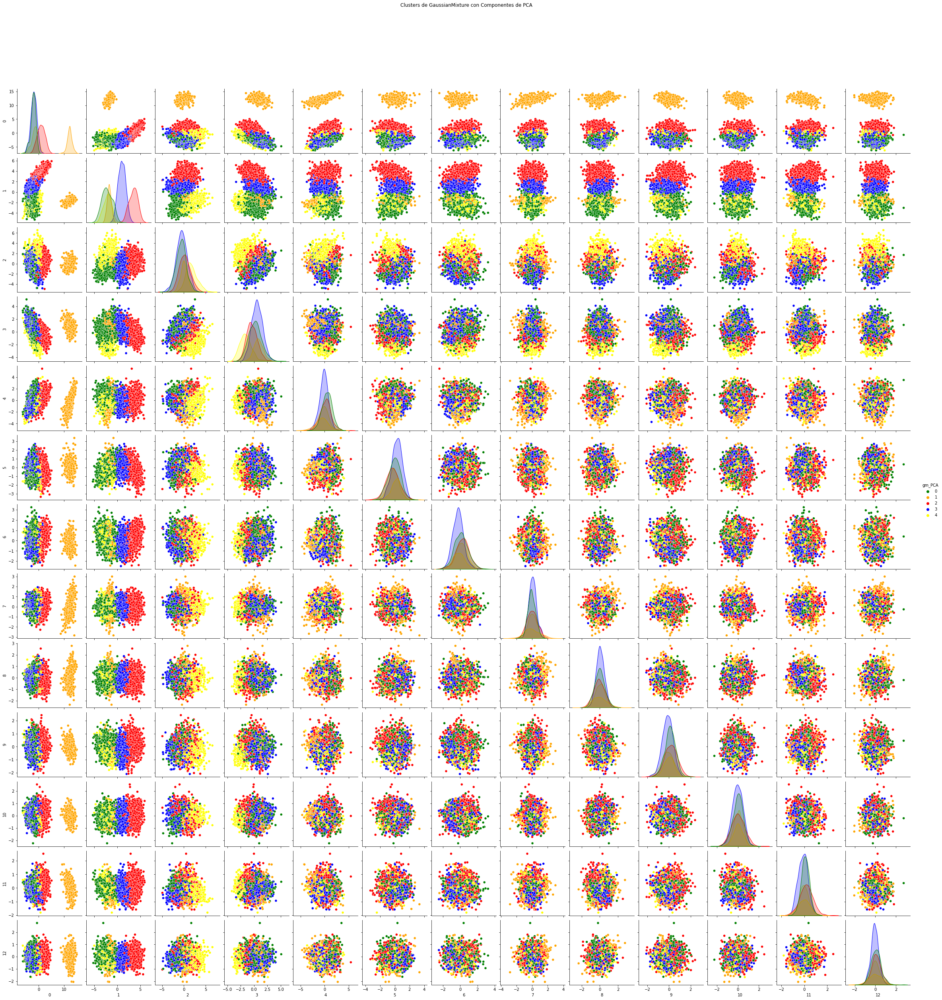

In [48]:
#450 Graficamos de a pares los clusters de GaussianMixture que se formaron por las componentes de PCA
#NOTA: el procesamiento tarda unos minutos
palette=['green', 'orange', 'red', 'blue', 'yellow']
g = sns.pairplot(df_clusters_Gm_PCA, hue='gm_PCA', palette=palette)
g.fig.suptitle('Clusters de GaussianMixture con Componentes de PCA', y=1.08); 

**Del gráfico anterior podemos ver que se separan mejor los clusters en el conjunto de componentes con más varianza.**

Arriba a la izquierda partiendo de la componente 0 están las variables con mayor varianza y donde más se separan los clusters.
Abajo a la derecha en la componente 12 tenemos la de menor varianza y donde menos se separan los clusters.


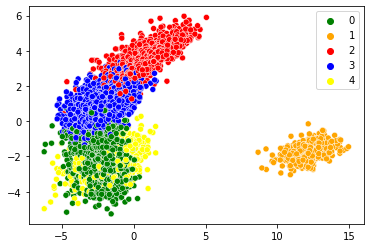

In [49]:
#460 Hacemos zoom en el grafico de las 2 componentes con mas varianza
palette=['green', 'orange', 'red', 'blue', 'yellow']
#palette=['green', 'orange', 'brown', 'red', 'blue', 'yellow']
sns.scatterplot(x = pca_res[:,0], y = pca_res[:,1], hue= clusters_Gm_PCA, palette=palette)

--------------------------------------------------------------------------------
## **CONSIGNA 4** - Evaluación y Análisis de los clústers encontrados.

### 4.1. Evaluación y Análisis de los clústers encontrados con K-Means sin y con PCA

In [50]:
#470  Verificamos los clusters encontrados según zonas de juego con crosstab para KM (solo)
#Reduce la posiciones en Arqueros, Defensores, Mediocampistas y Delanteros
pd.crosstab(df_clusters_Km.kmeans_4, dfcopy.zona_de_juego)

zona_de_juego,Defender,Forward,GK,Midfielder
kmeans_4,,,,
0,729,48,0,158
1,0,0,444,0
2,0,1153,0,336
3,318,310,0,1097


In [51]:
#480  Verificamos los clusters encontrados según zonas de juego con crosstab para KM con PCA
#Reduce la posiciones en Arqueros, Defensores, Mediocampistas y Delanteros
pd.crosstab(df_clusters_Km_PCA.kmeans_PCA_4, dfcopy.zona_de_juego)

zona_de_juego,Defender,Forward,GK,Midfielder
kmeans_PCA_4,,,,
0,0,0,444,0
1,0,1167,0,375
2,719,46,0,143
3,328,298,0,1073


In [52]:
#490 Sacamos la cantidad total de los mejores jugadores para cada zona de juego
df_mejores["zona_de_juego"].value_counts()

Midfielder    1591
Forward       1511
Defender      1047
GK             444
Name: zona_de_juego, dtype: int64

### **Evaluamos si es mejor agrupar con KM solo o con KM con PCA**

Metodo: comparamos el valor "mayor" de cada zona de juego correspondiente a cada cluster, contra el valor total de la zona de juego (para saber si los clusters tienen alguna relación de agrupamiento en base a zona de juego).

Kmeans solo:

1.   GK = 444 / 444 = 100%
2.   Defender = 729 / 1047 = 69%
3.   Midfielder = 1097 / 1591 = 69%
4.   Forward = 1153 / 1511 = 76%

Kmeans PCA:

1.   GK = 444 / 444 = 100%
2.   Defender = 719 / 1047 = 68%
3.   Midfielder = 1074 / 1591 = 67%
4.   Forward = 1167 / 1511 = 77%

### Análisis de crosstab:

Usando PCA para reducir la dimensionalidad (antes de Kmeans), no hubo diferencia significativa contra solo usar Kmeans.


#**Coeficiente Silhouette en KM**

In [53]:
#500	Coeficiente Silhouette KM solo
for i in range (2, 13):
  clusterer = KMeans(n_clusters=i, random_state=10)
  cluster_labels = clusterer.fit_predict(df_clusters_Km)
  silhouette_avg = silhouette_score(df_clusters_Km, cluster_labels)
  print("Para el cluster =", i, "el silhouette promedio es: {:.2f}%".format(silhouette_avg * 100))

Para el cluster = 2 el silhouette promedio es: 63.66%
Para el cluster = 3 el silhouette promedio es: 35.21%
Para el cluster = 4 el silhouette promedio es: 32.45%
Para el cluster = 5 el silhouette promedio es: 28.43%
Para el cluster = 6 el silhouette promedio es: 23.84%
Para el cluster = 7 el silhouette promedio es: 22.77%
Para el cluster = 8 el silhouette promedio es: 21.48%
Para el cluster = 9 el silhouette promedio es: 19.85%
Para el cluster = 10 el silhouette promedio es: 18.97%
Para el cluster = 11 el silhouette promedio es: 17.76%
Para el cluster = 12 el silhouette promedio es: 17.25%


In [54]:
#510 Coeficiente Silhouette para KM con PCA
for i in range (2, 13):
  clusterer = KMeans(n_clusters=i, random_state=10)
  cluster_labels = clusterer.fit_predict(df_clusters_Km_PCA)
  silhouette_avg = silhouette_score(df_clusters_Km_PCA, cluster_labels)
  print("Para el cluster =", i, "el silhouette promedio es: {:.2f}%".format(silhouette_avg * 100))

Para el cluster = 2 el silhouette promedio es: 62.09%
Para el cluster = 3 el silhouette promedio es: 30.04%
Para el cluster = 4 el silhouette promedio es: 31.35%
Para el cluster = 5 el silhouette promedio es: 29.46%
Para el cluster = 6 el silhouette promedio es: 25.04%
Para el cluster = 7 el silhouette promedio es: 24.37%
Para el cluster = 8 el silhouette promedio es: 23.48%
Para el cluster = 9 el silhouette promedio es: 21.32%
Para el cluster = 10 el silhouette promedio es: 21.08%
Para el cluster = 11 el silhouette promedio es: 19.62%
Para el cluster = 12 el silhouette promedio es: 14.92%


## Análisis de Silhouette:

Para 2 clusters: Podemos apreciar que silhouette da mejor con Kmeans solo (contra Kmeans con PCA). NOTA: 2 clusters separa arqueros del resto de los jugadores.

Para 4 clusters: Podemos apreciar que silhouette tiene un  valor similar que para el silhouette de 3 clusters


Para número de clusters = 2 el silhouette promedio es: 63.66%
Para número de clusters = 3 el silhouette promedio es: 35.21%
Para número de clusters = 4 el silhouette promedio es: 32.45%
Para número de clusters = 5 el silhouette promedio es: 28.43%
Para número de clusters = 6 el silhouette promedio es: 23.84%
Para número de clusters = 7 el silhouette promedio es: 22.77%
Para número de clusters = 8 el silhouette promedio es: 21.48%


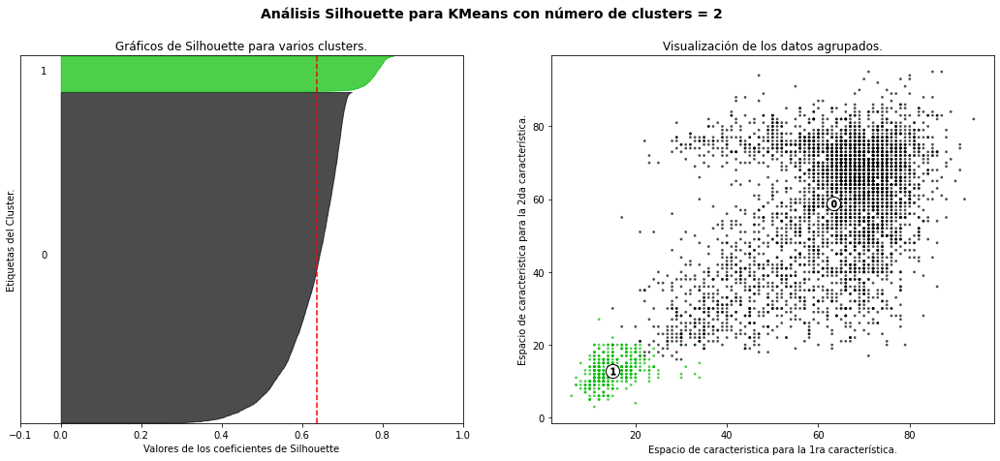

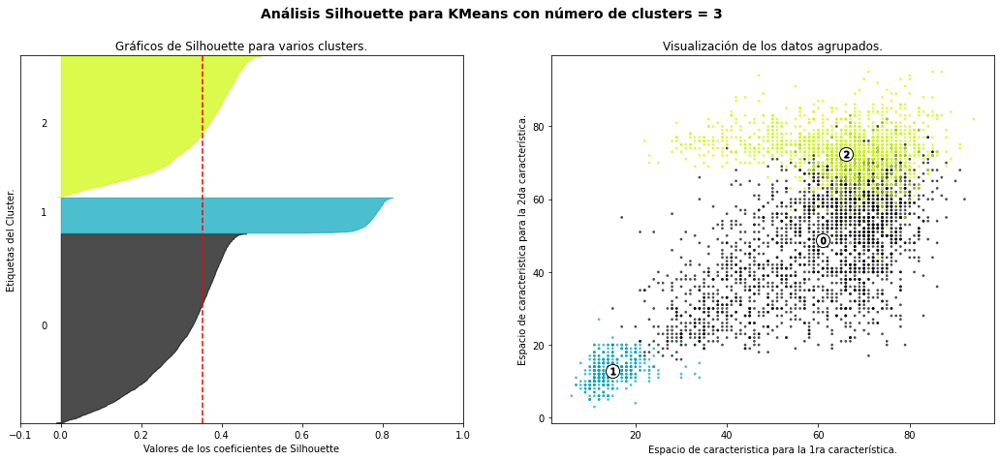

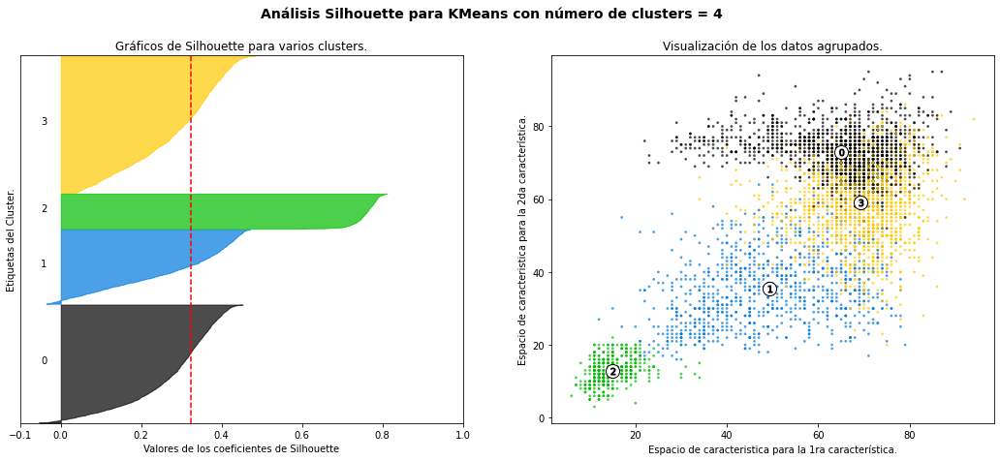

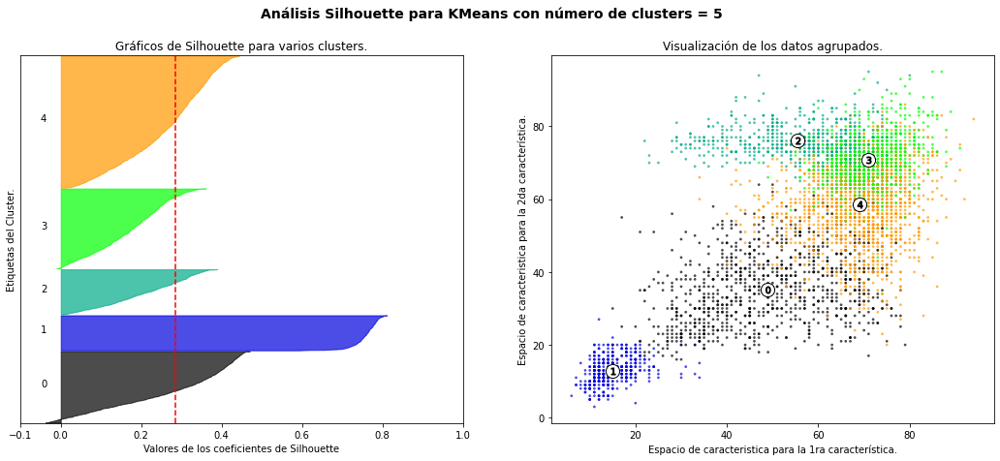

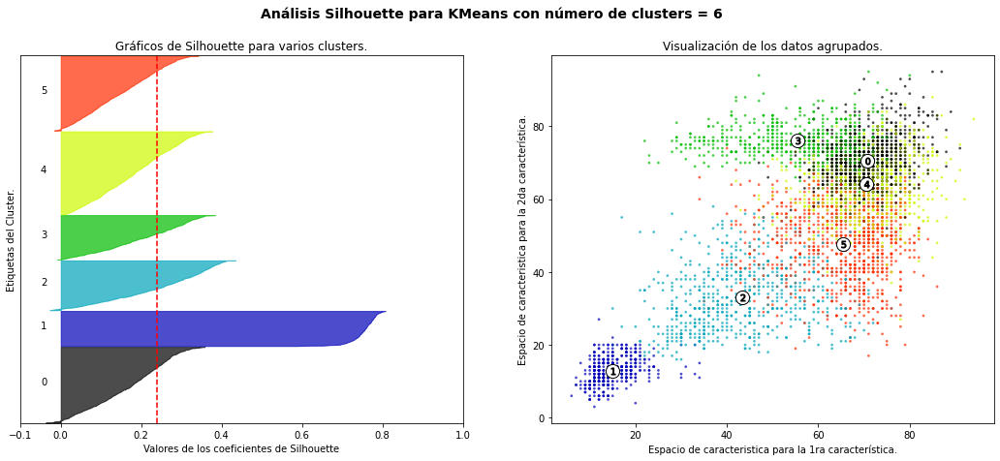

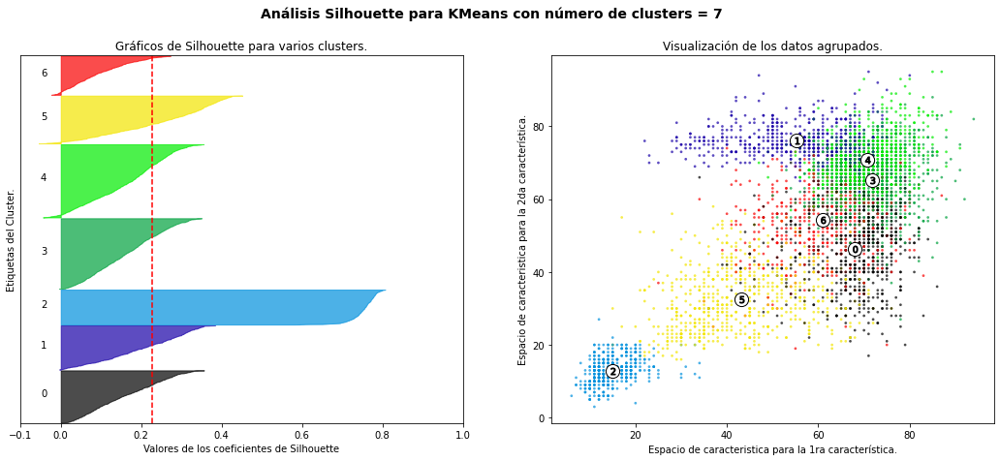

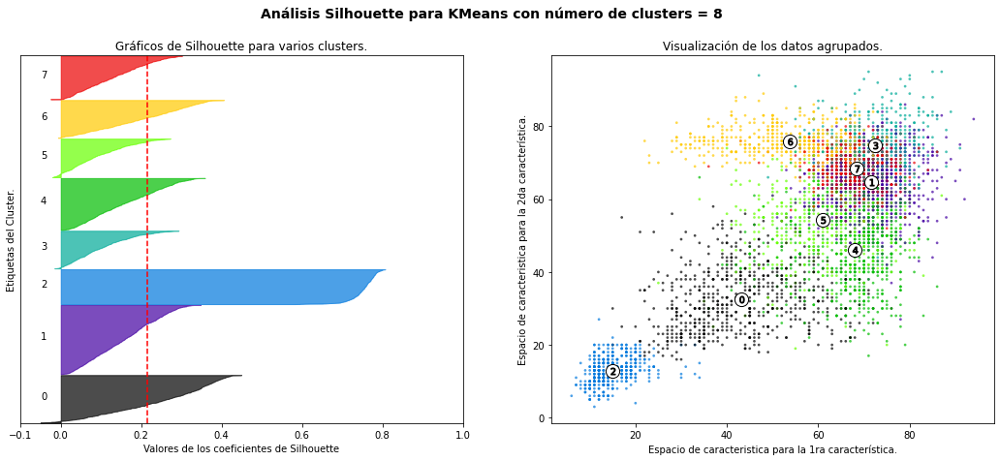

In [55]:
#520 Graficamos los valores de Silhouette para un mejor análisis y comprensión: KMeans solo

#NOTA: Código modificado de:
#https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py

X = df_clusters_Km 
y = df_clusters_Km.kmeans_4

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("Para número de clusters =", n_clusters, "el silhouette promedio es: {:.2f}%".format(silhouette_avg * 100))

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Gráficos de Silhouette para varios clusters.")
    ax1.set_xlabel("Valores de los coeficientes de Silhouette")
    ax1.set_ylabel("Etiquetas del Cluster.")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X.iloc[:, 0], X.iloc[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("Visualización de los datos agrupados.")
    ax2.set_xlabel("Espacio de caracteristica para la 1ra característica.")
    ax2.set_ylabel("Espacio de caracteristica para la 2da característica.")

    plt.suptitle(
        "Análisis Silhouette para KMeans con número de clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

Para número de clusters = 2 el silhouette promedio es: 62.09%
Para número de clusters = 3 el silhouette promedio es: 30.04%
Para número de clusters = 4 el silhouette promedio es: 31.35%
Para número de clusters = 5 el silhouette promedio es: 29.46%
Para número de clusters = 6 el silhouette promedio es: 25.04%
Para número de clusters = 7 el silhouette promedio es: 24.37%
Para número de clusters = 8 el silhouette promedio es: 23.48%


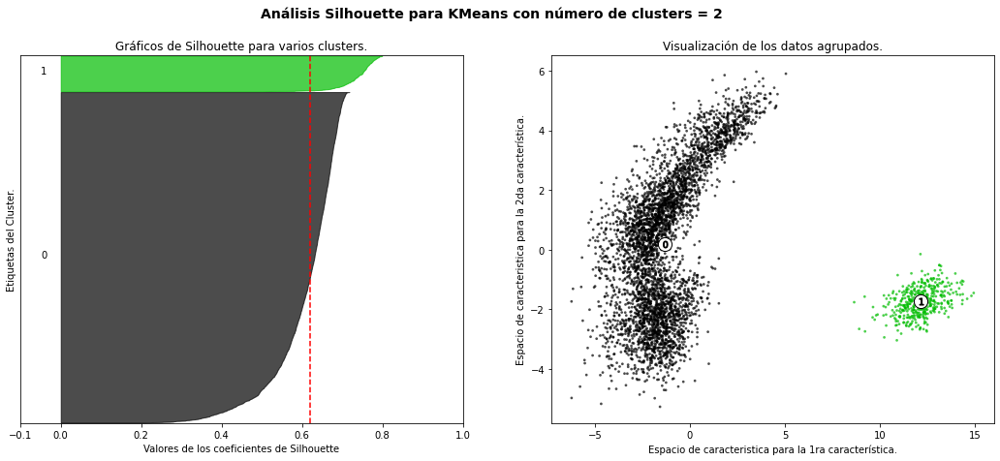

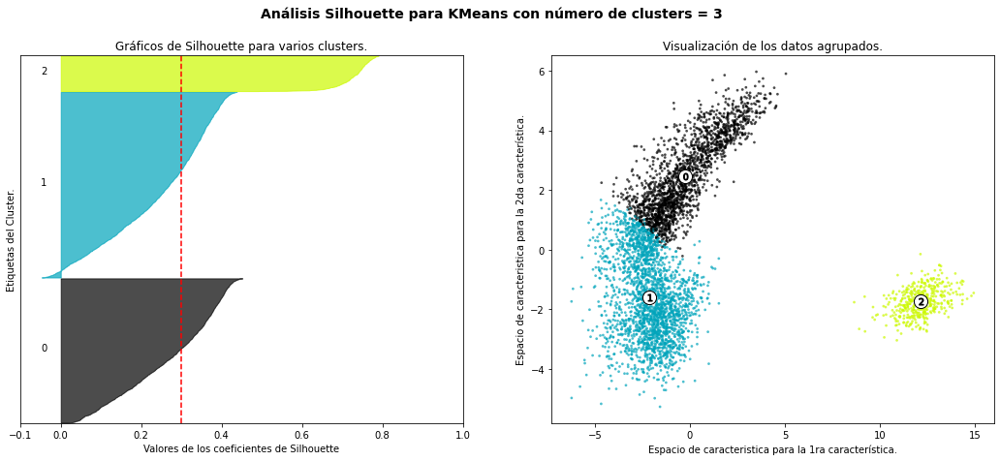

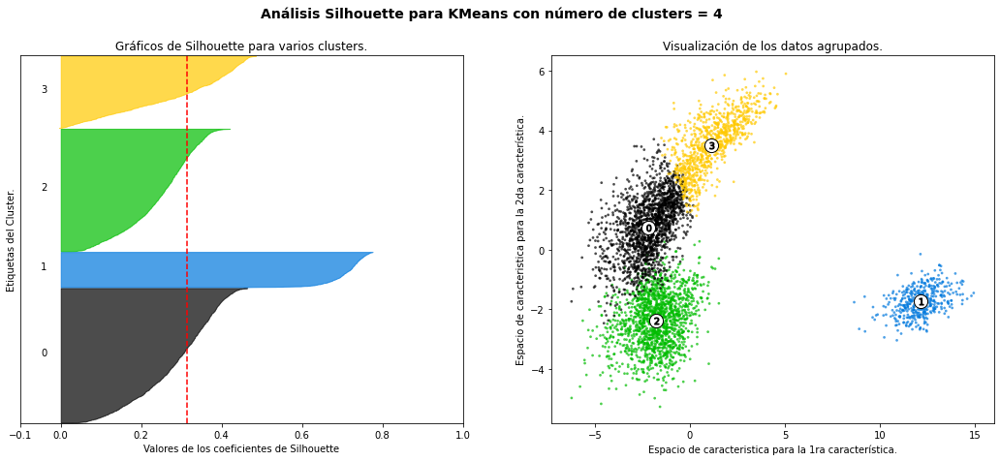

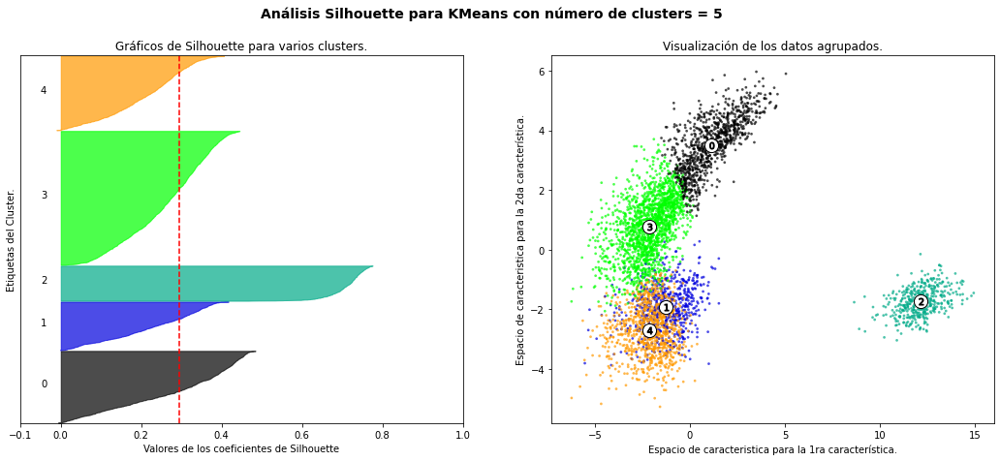

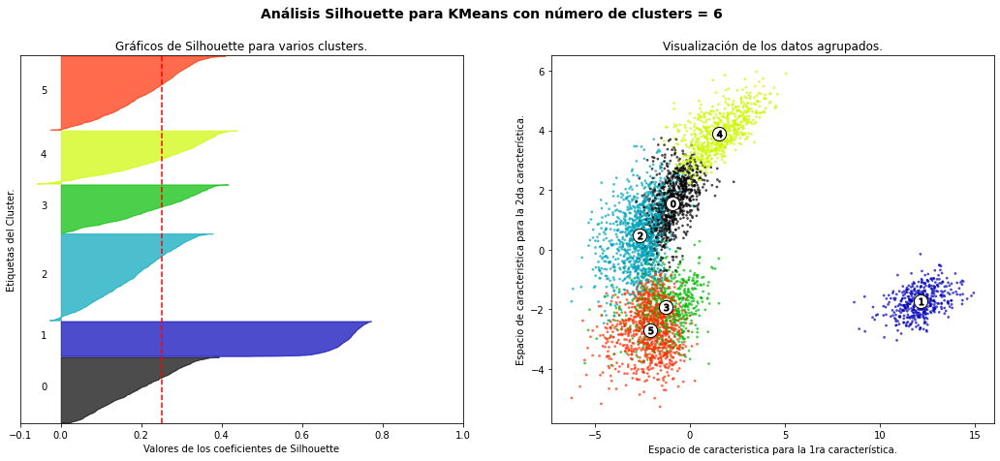

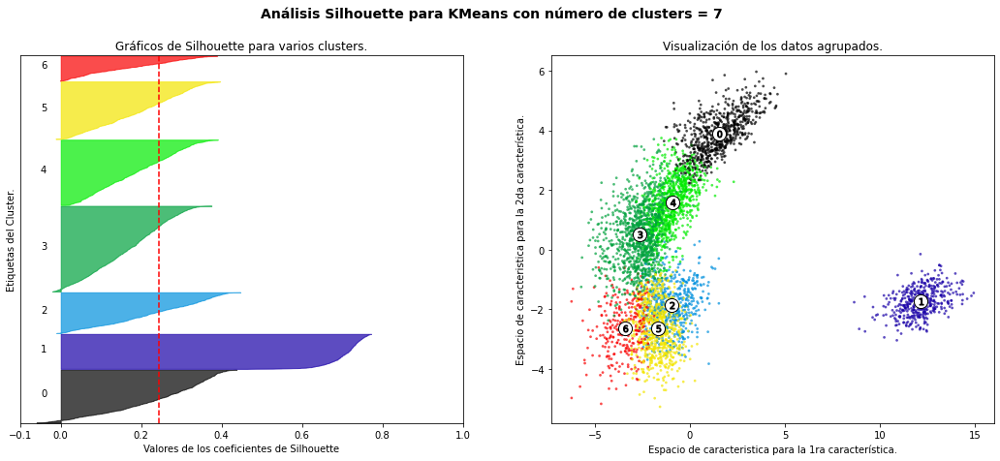

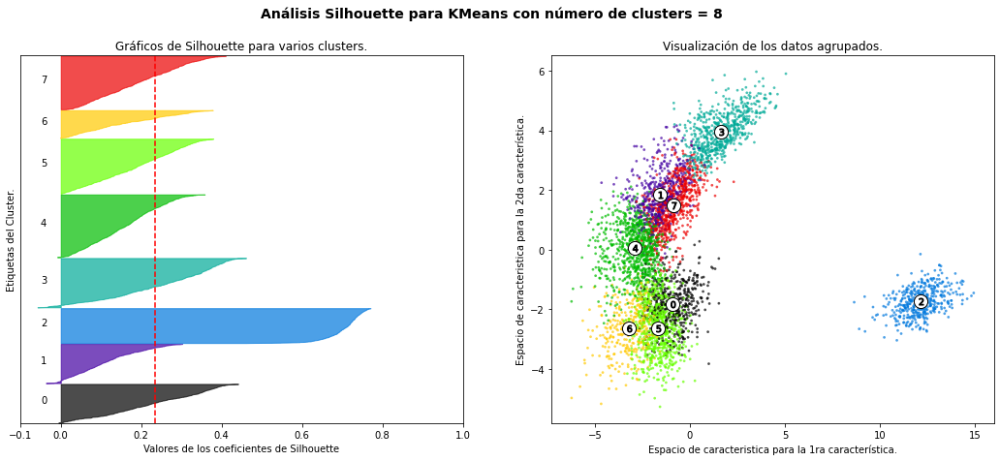

In [56]:
#530 Graficamos los valores de Silhouette para un mejor análisis y comprensión: Kmeans con PCA 

#NOTA: Código modificado de:
#https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py

X = df_clusters_Km_PCA 
y = df_clusters_Km_PCA.kmeans_PCA_4

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("Para número de clusters =", n_clusters, "el silhouette promedio es: {:.2f}%".format(silhouette_avg * 100))

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Gráficos de Silhouette para varios clusters.")
    ax1.set_xlabel("Valores de los coeficientes de Silhouette")
    ax1.set_ylabel("Etiquetas del Cluster.")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X.iloc[:, 0], X.iloc[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("Visualización de los datos agrupados.")
    ax2.set_xlabel("Espacio de caracteristica para la 1ra característica.")
    ax2.set_ylabel("Espacio de caracteristica para la 2da característica.")

    plt.suptitle(
        "Análisis Silhouette para KMeans con número de clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

###4.2. Evaluación y Análisis de los clústers encontrados con Mezcla de gaussianas sin y con PCA

In [57]:
#540  Verificamos los clusters encontrados según zonas de juego con crosstab para GMM (solo)

#Reduce la posiciones en Arqueros, Defensores, Mediocampistas y Delanteros
pd.crosstab(df_clusters_Gm.gm_4, dfcopy.zona_de_juego)

zona_de_juego,Defender,Forward,GK,Midfielder
gm_4,,,,
0,245,236,0,868
1,0,0,444,0
2,801,62,0,252
3,1,1213,0,471


Análisis de clusters encontrados con PCA

Cluster 0: Delanteros

Cluster 1: Mayormente Mediocampistas

Cluster 2: Arqueros

Cluster 3:  Mayormente Defensores


In [58]:
#550  Verificamos los clusters encontrados según zonas de juego con crosstab para GMM con PCA
#Reduce la posiciones en Arqueros, Defensores, Mediocampistas y Delanteros
pd.crosstab(df_clusters_Gm_PCA.gm_PCA, dfcopy.zona_de_juego)

zona_de_juego,Defender,Forward,GK,Midfielder
gm_PCA,,,,
0,3,575,0,541
1,0,0,444,0
2,719,23,0,173
3,325,254,0,858
4,0,659,0,19


Análisis de clusters encontrados con PCA

Cluster 0: Mayormente Defensores

Cluster 1: Mayormente Mediocampistas

Cluster 2: Arqueros

Cluster 3: Mayormente Delanteros

Cluster 4: Posición Mixta entre Mediocampistas y Delanteros



#**Coeficiente Silhouette en GMM**

Para número de clusters = 2 el silhouette promedio es: 63.66%
Para número de clusters = 3 el silhouette promedio es: 35.22%
Para número de clusters = 4 el silhouette promedio es: 32.44%
Para número de clusters = 5 el silhouette promedio es: 28.43%
Para número de clusters = 6 el silhouette promedio es: 23.84%
Para número de clusters = 7 el silhouette promedio es: 22.78%
Para número de clusters = 8 el silhouette promedio es: 21.47%


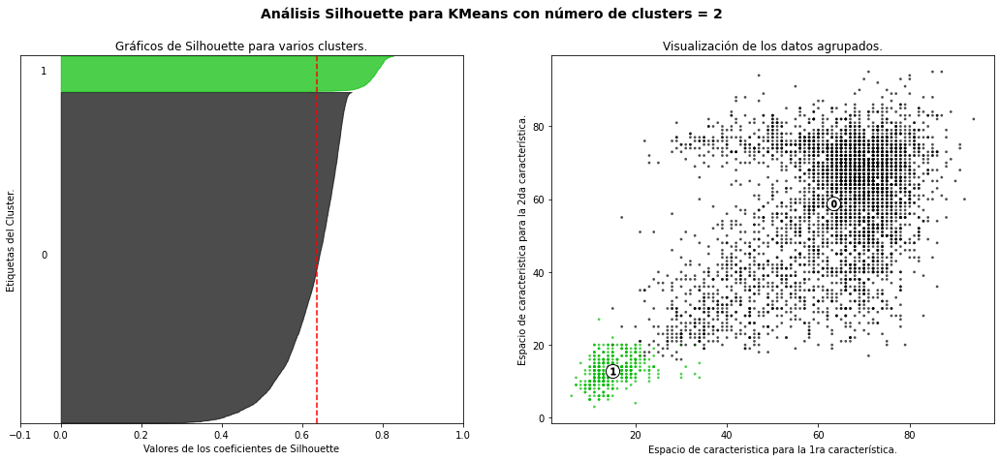

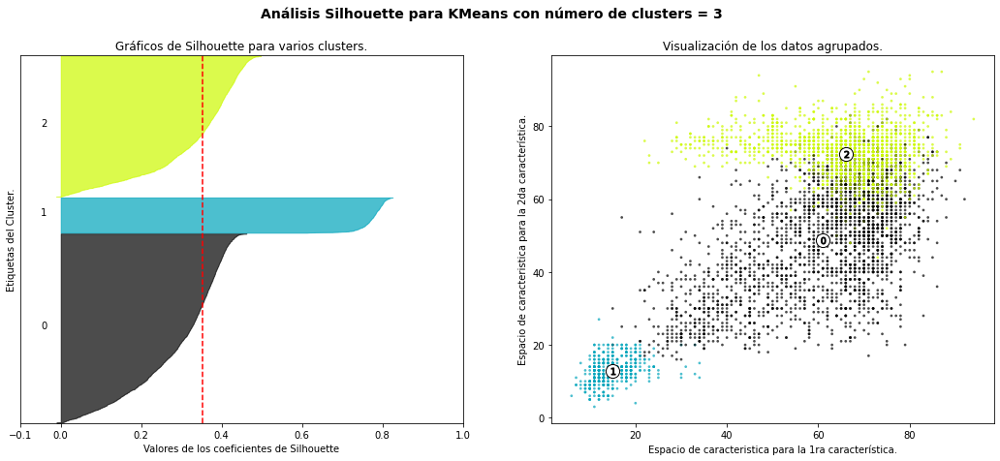

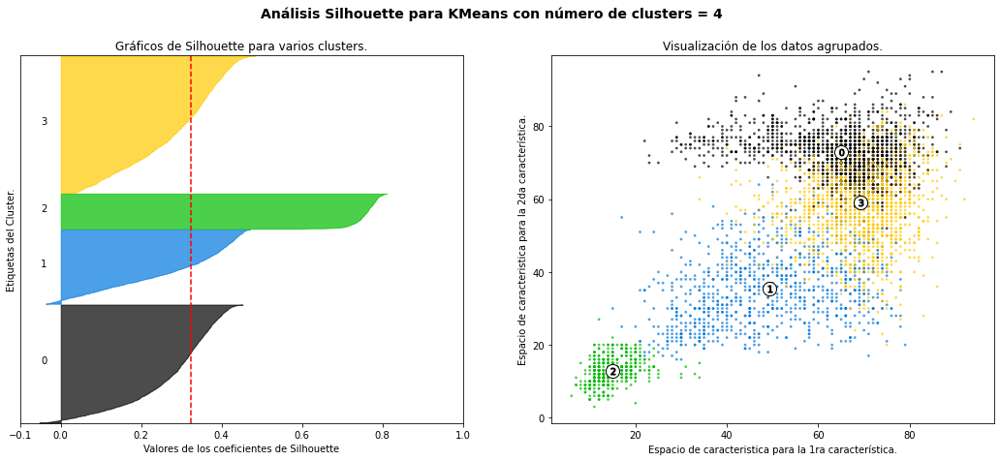

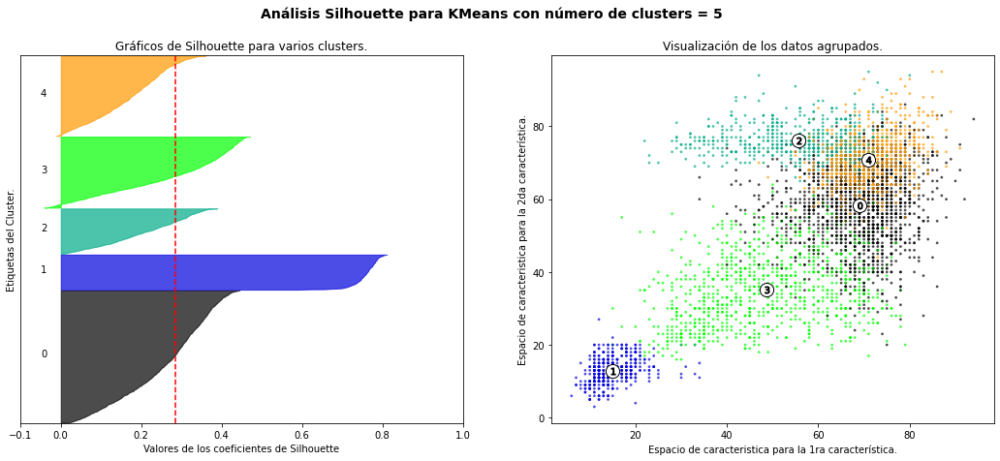

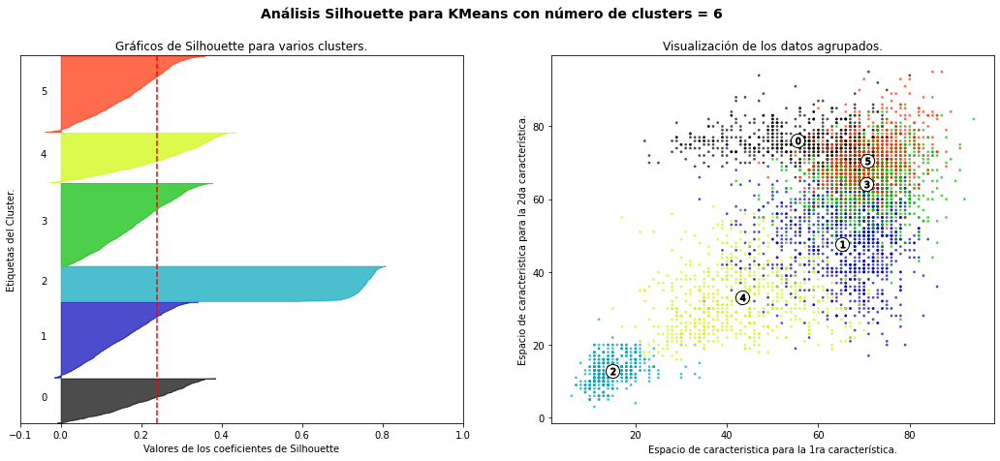

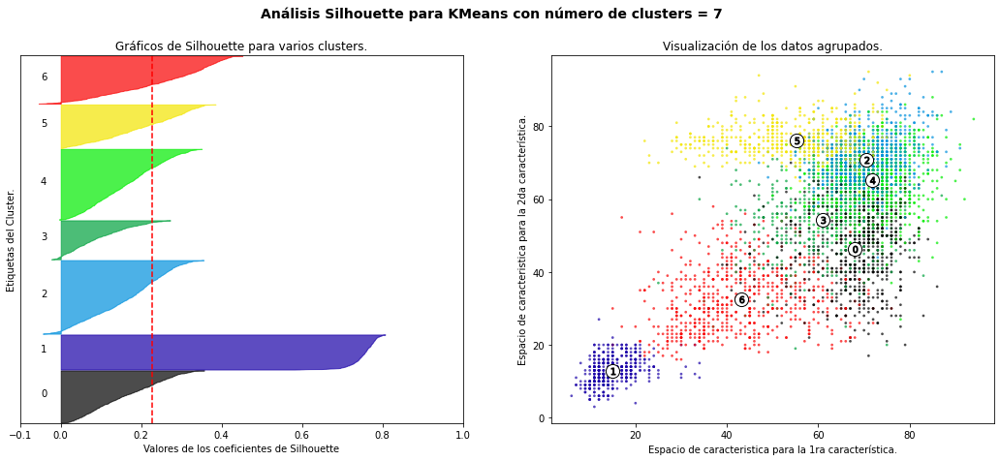

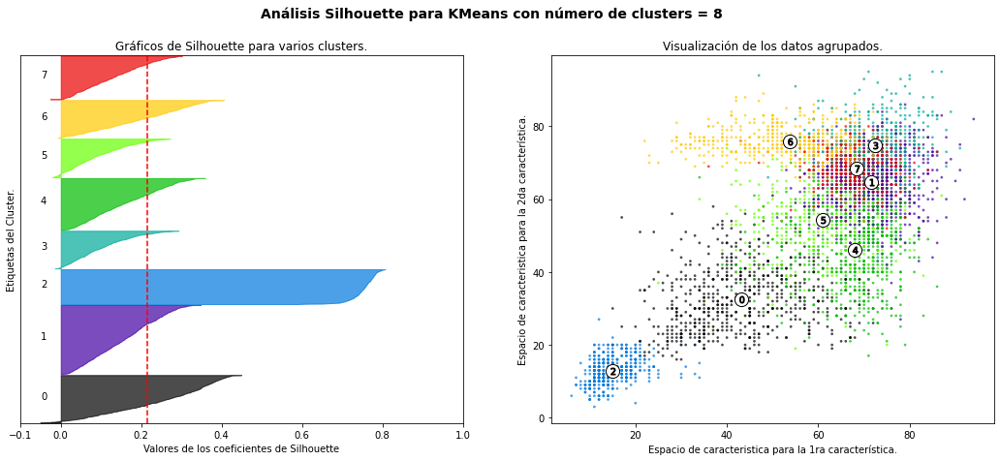

In [59]:
#560 Graficamos los valores de Silhouette para un mejor análisis y comprensión: GMM  

#NOTA: Código modificado de:
#https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py

X = df_clusters_Gm
y = df_clusters_Gm.gm_4

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("Para número de clusters =", n_clusters, "el silhouette promedio es: {:.2f}%".format(silhouette_avg * 100))

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Gráficos de Silhouette para varios clusters.")
    ax1.set_xlabel("Valores de los coeficientes de Silhouette")
    ax1.set_ylabel("Etiquetas del Cluster.")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X.iloc[:, 0], X.iloc[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("Visualización de los datos agrupados.")
    ax2.set_xlabel("Espacio de caracteristica para la 1ra característica.")
    ax2.set_ylabel("Espacio de caracteristica para la 2da característica.")

    plt.suptitle(
        "Análisis Silhouette para KMeans con número de clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

Para número de clusters = 2 el silhouette promedio es: 60.60%
Para número de clusters = 3 el silhouette promedio es: 28.48%
Para número de clusters = 4 el silhouette promedio es: 29.33%
Para número de clusters = 5 el silhouette promedio es: 33.66%
Para número de clusters = 6 el silhouette promedio es: 28.90%
Para número de clusters = 7 el silhouette promedio es: 25.64%
Para número de clusters = 8 el silhouette promedio es: 24.80%


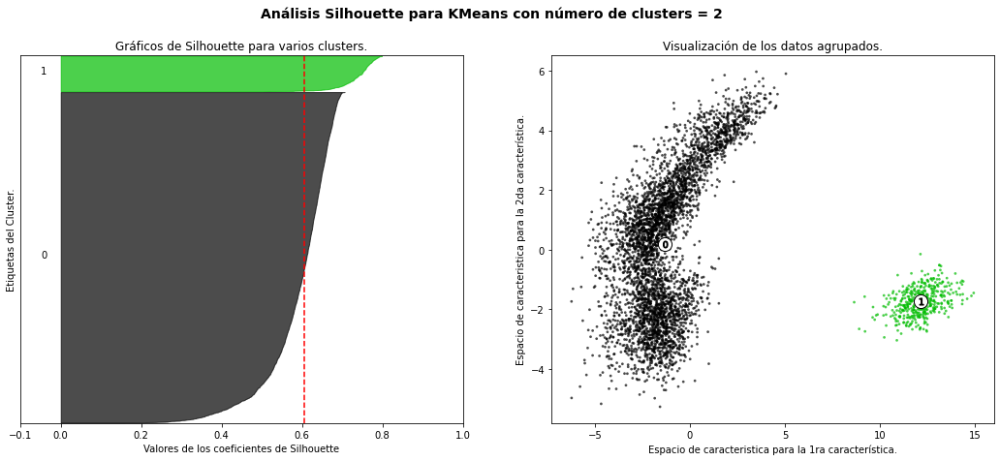

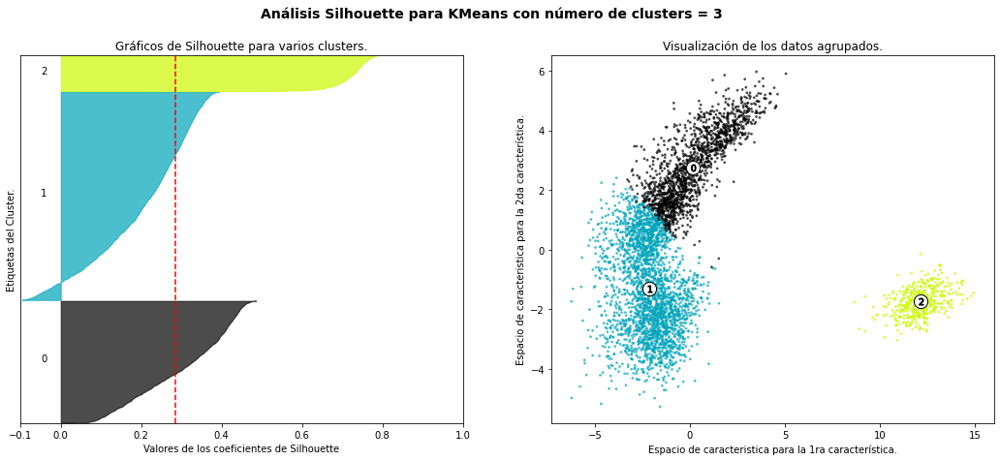

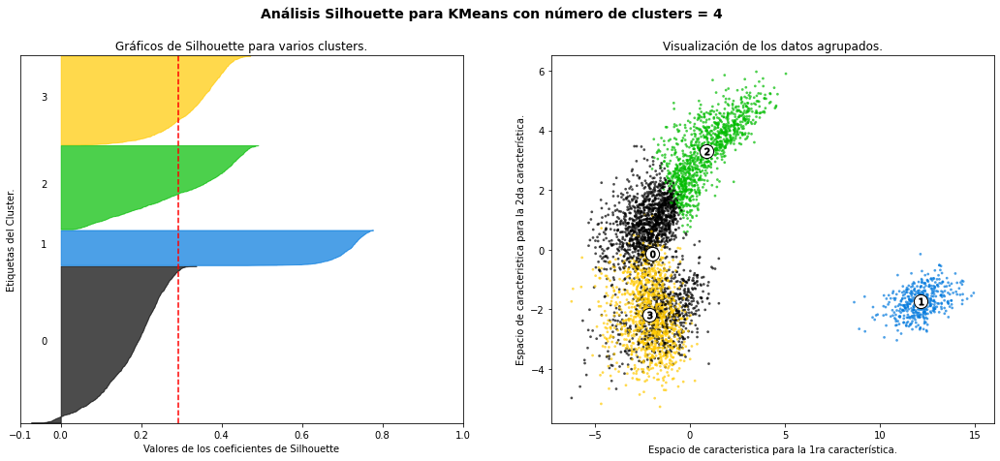

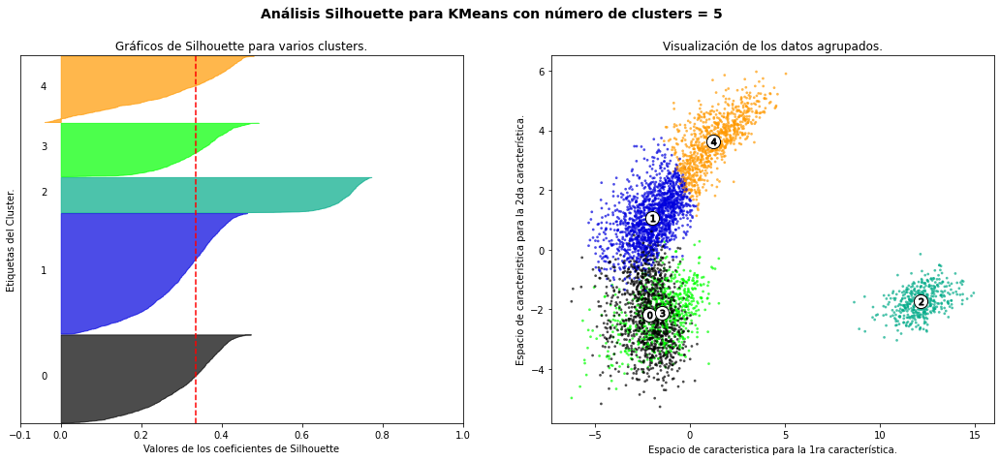

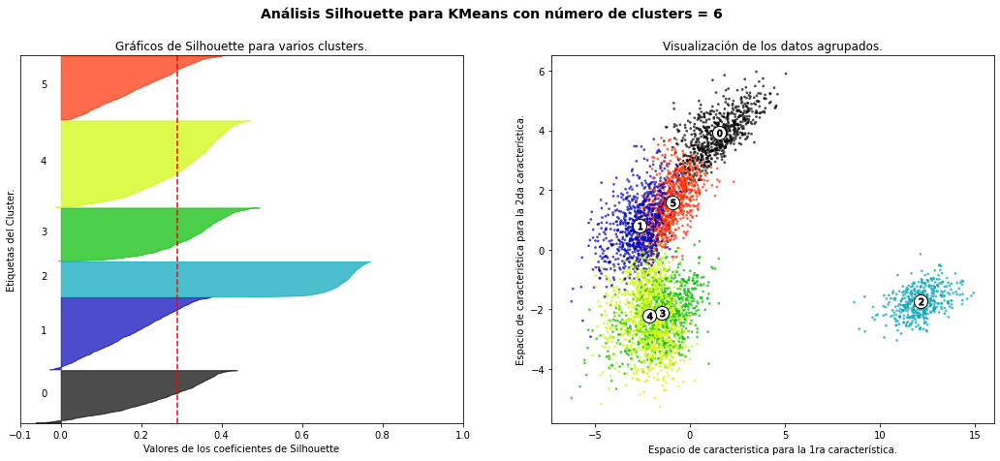

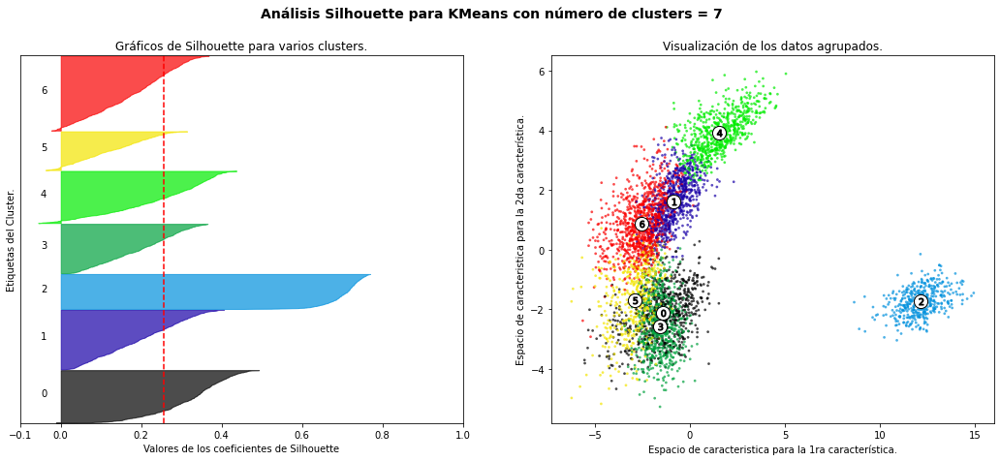

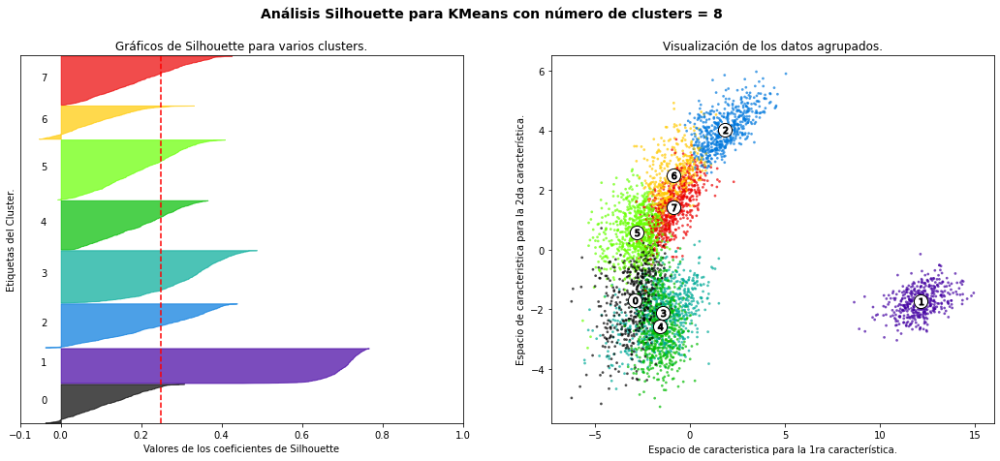

In [60]:
#570 Graficamos los valores de Silhouette para un mejor análisis y comprensión: GMM con PCA 

#NOTA: Código modificado de:
#https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py

X = df_clusters_Gm_PCA 
y = df_clusters_Gm_PCA.gm_PCA

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("Para número de clusters =", n_clusters, "el silhouette promedio es: {:.2f}%".format(silhouette_avg * 100))

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Gráficos de Silhouette para varios clusters.")
    ax1.set_xlabel("Valores de los coeficientes de Silhouette")
    ax1.set_ylabel("Etiquetas del Cluster.")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X.iloc[:, 0], X.iloc[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("Visualización de los datos agrupados.")
    ax2.set_xlabel("Espacio de caracteristica para la 1ra característica.")
    ax2.set_ylabel("Espacio de caracteristica para la 2da característica.")

    plt.suptitle(
        "Análisis Silhouette para KMeans con número de clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

--------------------------------------------------------------------------------
## **CONSIGNA 5** - Pregunta: ¿Se realizó alguna normalización o escalado de la base? ¿Por qué?

Es necesario que los datos se encuentren escalados ya que K-means es susceptible a diferentes escalas de los datos. 

En el dataset las variables utilizadas estaban en escala 0 - 100, es decir en el mismo orden de magnitud. 

Hemos probado con y sín escalado. Kmeans lo utilizamos sin escalar y Kmeans con PCA lo utilizamos con escalado (StandardScaler).

Como conclusión, hemos observado que no hay diferencia significativa entre uno y otro (debido a que el dataset ya estaba escalado).

En el punto 6 vamos a aplicar StandarScaler, el cual estándariza los datos eliminando la media y escalando los mismos, para luego poder realizar PCA y T-SNE a los datos previamente estandarizados.


--------------------------------------------------------------------------------
## **CONSIGNA 6** - Uso de alguna transformación (proyección, Embedding) para visualizar los resultados y/o usarla como preprocesado para aplicar alguna técnica de clustering.

In [61]:
#580 Partimos del dataset de los mejores jugadores aplicando PCA y T-SNE

df_best= df_mejores.copy()
df_best.head(3)

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,...,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,zona_de_juego,kmeans_4,kmeans_PCA_4
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000.0,320000.0,34,1987-06-24,170,72,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,NaN,2021-08-10,2023.0,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,...,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,Forward,2,1
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000.0,270000.0,32,1988-08-21,185,81,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,NaN,2014-07-01,2023.0,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,...,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png,Forward,2,1
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000.0,270000.0,36,1985-02-05,187,83,11.0,Manchester United,English Premier League,1.0,ST,7.0,NaN,2021-08-27,2023.0,38,Portugal,1354.0,ST,7.0,Right,4,5,5,High/Low,Unique,Yes,83300000.0,"#Aerial Threat, #Dribbler, #Distance Shooter, ...","Power Free-Kick, Flair, Long Shot Taker (AI), ...",87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,...,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png,Forward,2,1


In [62]:
#590 Reemplazamos las zonas de juego por valores numéricos 
dict_replace = {'Defender' : 1, 'Forward' : 3, 'GK' : 0, 'Midfielder' : 2}
df_best['Position3'] = df_best['zona_de_juego']
df_best.replace({"Position3": dict_replace}, inplace=True)
df_best["Position3"].value_counts()

2    1591
3    1511
1    1047
0     444
Name: Position3, dtype: int64

In [63]:
#600 Obtenemos el dataset "estandarizado" (en base al dataset de mejores jugadores y reducido a las habilidades seleccionadas)
skills4_ratings = ['attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing', 'attacking_volleys', 
                  'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control', 
                  'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_reactions', 'movement_balance',
                  'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
                  'mentality_aggression', 'mentality_interceptions', 'mentality_positioning', 'mentality_vision', 'mentality_penalties', 'mentality_composure',
                  'defending_marking_awareness', 'defending_standing_tackle', 'defending_sliding_tackle',
                  'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning', 'goalkeeping_reflexes','kmeans_4','kmeans_PCA_4', 'Position3']

standarized = pd.DataFrame(StandardScaler().fit_transform(df_best[skills4_ratings]))
standarized.columns = df_best[skills4_ratings].columns #recuperamos los nombres de las columnas
standarized.head(3)

,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,kmeans_4,kmeans_PCA_4,Position3
0,1.386087,1.959048,0.602241,1.665113,1.886927,1.663029,1.813105,2.247957,1.989261,1.731954,1.573213,0.820028,1.585420,3.948669,1.965953,1.569742,-0.082078,0.139703,-0.087596,1.843995,-1.182558,-0.669270,1.628123,2.390008,1.211457,2.878840,-1.601549,-0.860727,-1.206481,-0.554899,-0.300009,-0.076737,-0.142588,-0.449146,0.11379,-0.814023,1.129592
1,0.652733,1.959048,1.686878,1.226836,1.938467,1.077552,1.099515,1.780778,0.515083,1.239427,0.614216,0.750339,0.612145,3.770152,1.072468,1.910652,1.318433,0.403325,1.388686,1.496800,0.988090,-0.257150,1.724629,1.326433,2.109057,2.020222,-0.899752,-0.555828,-1.423616,-0.091302,-0.568435,-0.243249,-0.455443,-0.348454,0.11379,-0.814023,1.129592
2,1.490852,1.959048,1.686878,0.861605,1.783846,1.237227,1.201457,1.728869,1.006476,1.239427,1.162215,1.377548,1.237821,3.948669,0.522632,2.251562,2.142263,0.469231,0.607125,1.794396,-0.067901,-1.172972,1.724629,0.946585,1.989377,2.771513,-1.414403,-0.991398,-1.206481,-0.503389,-0.300009,-0.076737,-0.142588,-0.298108,0.11379,-0.814023,1.129592


componentes: 1, varianza: 53.08%, varianza acumulada: 53.08%
componentes: 2, varianza: 17.05%, varianza acumulada: 70.12%
componentes: 3, varianza: 5.98%, varianza acumulada: 76.11%
componentes: 4, varianza: 5.36%, varianza acumulada: 81.47%
componentes: 5, varianza: 3.53%, varianza acumulada: 85.00%
componentes: 6, varianza: 2.43%, varianza acumulada: 87.43%
componentes: 7, varianza: 1.63%, varianza acumulada: 89.06%
componentes: 8, varianza: 1.13%, varianza acumulada: 90.20%
componentes: 9, varianza: 1.01%, varianza acumulada: 91.21%
componentes: 10, varianza: 0.87%, varianza acumulada: 92.08%
componentes: 11, varianza: 0.81%, varianza acumulada: 92.89%
componentes: 12, varianza: 0.73%, varianza acumulada: 93.62%
componentes: 13, varianza: 0.63%, varianza acumulada: 94.25%
componentes: 14, varianza: 0.58%, varianza acumulada: 94.83%
componentes: 15, varianza: 0.57%, varianza acumulada: 95.39%
componentes: 16, varianza: 0.51%, varianza acumulada: 95.90%
componentes: 17, varianza: 0.45

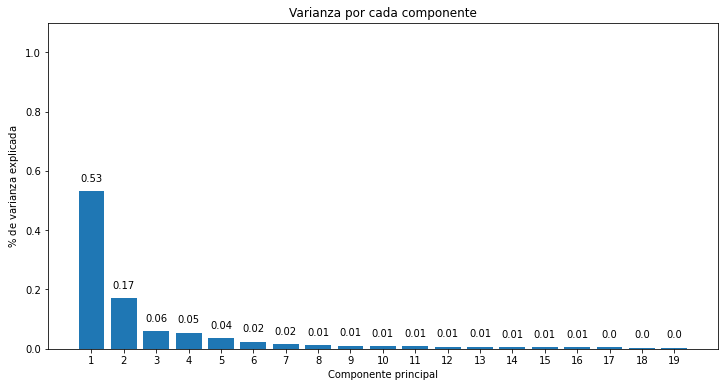

In [64]:
#601 Analizamos la varianza de las variables del dataset de mejores jugadores 

standard_scaler = standarized

for i in range(1, 20):
  pca = decomposition.PCA(n_components=i)
  pca_res = pca.fit(standard_scaler)
  print("componentes: {:d}, varianza: {:2.2f}%, varianza acumulada: {:2.2f}%".format(i, pca_res.explained_variance_ratio_[-1] * 100, pca_res.explained_variance_ratio_.sum() * 100))

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 6))
ax.bar(
    x      = np.arange(pca_res.n_components_) + 1,
    height = pca_res.explained_variance_ratio_
)

for x, y in zip(np.arange(len(df_skills4.columns)) + 1, pca_res.explained_variance_ratio_):
    label = round(y, 2)
    ax.annotate(
        label,
        (x,y),
        textcoords="offset points",
        xytext=(0,10),
        ha='center'
    )

ax.set_xticks(np.arange(pca_res.n_components_) + 1)
ax.set_ylim(0, 1.1)
ax.set_title('Varianza por cada componente')
ax.set_xlabel('Componente principal')
ax.set_ylabel('$\%$ de varianza explicada');

In [65]:
#610 Aplicamos PCA para los datos estandarizados 

df_best_n= pd.DataFrame(standarized)
pca = PCA(n_components=3)
pca_result = pca.fit_transform(df_best_n)
df_best_n['pca-1'] = pca_result[:,0]
df_best_n['pca-2'] = pca_result[:,1] 
df_best_n['pca-3'] = pca_result[:,2]
print('Varianza por componentes principales: {}'.format(pca.explained_variance_ratio_))

Varianza por componentes principales: [0.53076639 0.17045328 0.05983753]


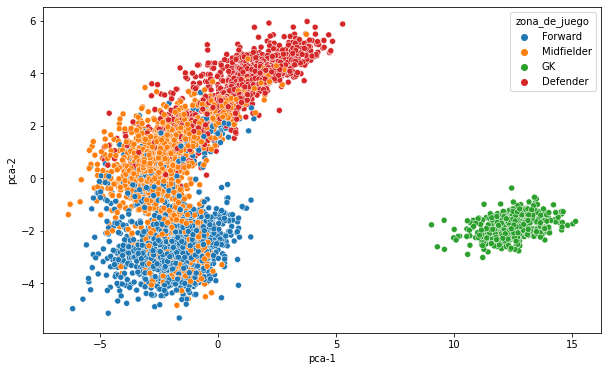

In [66]:
#620 Graficamos
plt.figure(figsize=(10,6))

sns.scatterplot(data=df_best_n, x="pca-1", y="pca-2", hue=df_best['zona_de_juego'])

plt.show()

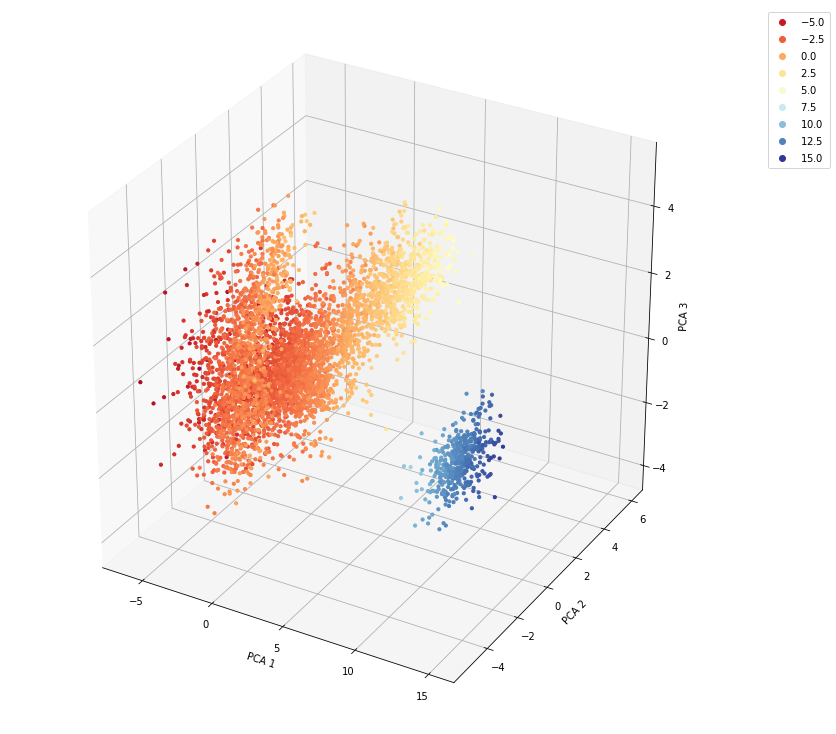

In [67]:
#630 graficamos en 3D para tener otra perspectiva 

x = df_best_n['pca-1']
y = df_best_n['pca-2']
z = df_best_n['pca-3']

fig = plt.figure(figsize=(10,10))
ax = Axes3D(fig)
fig.add_axes(ax)
sc = ax.scatter(x, y, z, s=40, c=x, marker='.', cmap='RdYlBu', alpha=1)
ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')
ax.set_zlabel('PCA 3')
plt.legend(*sc.legend_elements(), bbox_to_anchor=(1.05, 1), loc=2)
plt.show()

# T-SNE

In [68]:
#640 APLICAMOS T-SNE
import numpy as np
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, learning_rate='auto', verbose=1, random_state=123, perplexity=40, n_iter=500)
df_best_tsne2d = df_best_n.copy()
z = tsne.fit_transform(df_best_tsne2d)
z

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 4593 samples in 0.000s...
[t-SNE] Computed neighbors for 4593 samples in 1.027s...
[t-SNE] Computed conditional probabilities for sample 1000 / 4593
[t-SNE] Computed conditional probabilities for sample 2000 / 4593
[t-SNE] Computed conditional probabilities for sample 3000 / 4593
[t-SNE] Computed conditional probabilities for sample 4000 / 4593
[t-SNE] Computed conditional probabilities for sample 4593 / 4593
[t-SNE] Mean sigma: 1.136043
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.889908
[t-SNE] KL divergence after 500 iterations: 1.606357


array([[ 10.580457 ,   9.83344  ],
       [ 13.679356 ,  11.128021 ],
       [ 13.237261 ,  11.140605 ],
       ...,
       [-30.2655   ,  -0.9565664],
       [ 25.703957 ,   1.1464108],
       [-15.44915  ,   2.4274018]], dtype=float32)

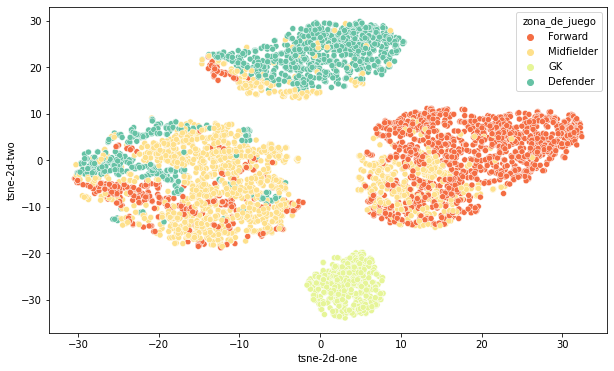

In [69]:
#650 Graficamos las 2 primeras componentes 
df_best_n['tsne-2d-one'] = z[:,0]
df_best_n['tsne-2d-two'] = z[:,1]
plt.figure(figsize=(10,6))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue = df_best['zona_de_juego'],  # 'Defender' : 1, 'Forward' : 3, 'GK' : 0, 'Midfielder' : 2}
    palette=sns.color_palette('Spectral',n_colors=4),
    data=df_best_n,
    legend="full",
    alpha=1
)

In [74]:
#660 Sumamos una componente más para graficar en 3D y tener otra perspectiva
tsne = TSNE(n_components=3, verbose=1, perplexity=80 , random_state=123 , n_iter=1500)
df_best_tsne3d = df_best_n.copy()
tsne_results = tsne.fit_transform(df_best_tsne3d)

[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 4593 samples in 0.000s...
[t-SNE] Computed neighbors for 4593 samples in 0.638s...
[t-SNE] Computed conditional probabilities for sample 1000 / 4593
[t-SNE] Computed conditional probabilities for sample 2000 / 4593
[t-SNE] Computed conditional probabilities for sample 3000 / 4593
[t-SNE] Computed conditional probabilities for sample 4000 / 4593
[t-SNE] Computed conditional probabilities for sample 4593 / 4593
[t-SNE] Mean sigma: 2.399814
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.734341
[t-SNE] KL divergence after 1500 iterations: 0.338728


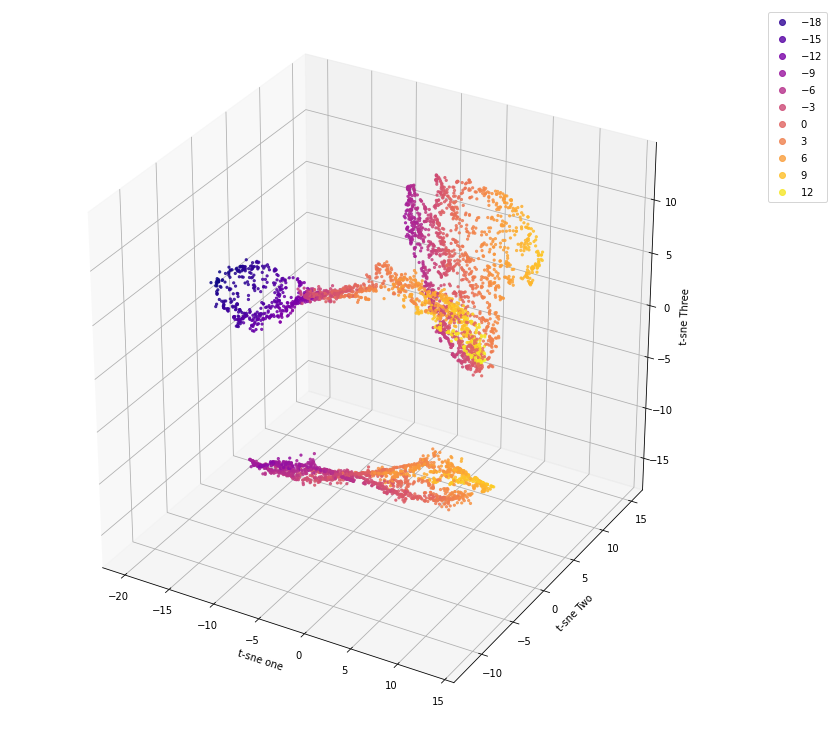

In [75]:
#670  Graficamos en 3D 
x = df_best_tsne3d['tsne-3d-one'] = tsne_results[:,0]
y =df_best_tsne3d['tsne-3d-two'] = tsne_results[:,1]
z = df_best_tsne3d['tsne-3d-three'] = tsne_results[:,2]
fig = plt.figure(figsize=(10,10))
ax = Axes3D(fig)
fig.add_axes(ax)
sc = ax.scatter(x, y, z, s=20, c=x, marker='.', cmap='plasma', alpha=0.8)
ax.set_xlabel('t-sne one')
ax.set_ylabel('t-sne Two')
ax.set_zlabel('t-sne Three')
plt.legend(*sc.legend_elements(), bbox_to_anchor=(1.05, 1), loc=2)
plt.show()

###**Conclusiones:**
Tanto con T-SNE como PCA no es posible diferenciar las posiciones forwards, midfielders, defenders según sus clusters. Esto puede deberse a consecuencia de características de los jugadores que son similares en posiciones distintas (ej: cabeceo es tanto para defensores como para delanteros)

